# Denoising diffusion model

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from typing import Optional, Tuple
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset
import math
import matplotlib.animation as animation
from IPython.display import HTML
import os

In [29]:
# x_T is pure noise random variable 
# x_0 is the image random variable you want to model
# p_theta(x_{t-1}|x_{t}) is a forward step, that removes noise (going twos the perfect image)
# q(x_t|x_{t-1}) is the noise addition step

# a diffusion probabalistic model is a parameterized markov chain 
# trained with variational inference to produce samples matching data after finite time 
#  When the diffusion consists of
# small amounts of Gaussian noise, it is sufficient to set the sampling chain transitions to conditional
# Gaussians too, allowing for a particularly simple neural network parameterization.


# p is the reverse process - not easy to figure out 
# q is the forward process  - easy to figure out

# p(x_0, x_1, x_2, x_3, ... , x_T) = p(x_T)p(x_{T-1}|x_T))p(x_{T-2}|x_{T-1}) ... p(x_1|x_2) p(x_0|x_1)

# p(x_T) ~ N(x_T|), I)

# p_θ(xt−1|xt) := N(xt−1; µθ(xt,t),Σθ(xt,t))
# at every point x_t-1 it is a gaussian centered at x_{t-1} parameterized by µθ(xt,t) and Σθ(xt,t)


# the reverse process is equivalent to the decoding chain


# the variational distribution
# the forward process adds noise to the neural network
# is fixed to a Markov chain that
# gradually adds Gaussian noise to the data according to a variance schedule
# beta_1, ... beta_T

# q(x1:T|x0) := product(T, t=1) q(x_t|x_{t-1})

# q(x1:5|x0) = q(x_1|x_0)q(x_2|x_1)q(x_4|x_3)q(x_5|x_4)q(x_5|x_4)

#  where each is  N(xt; sqrt(1−β_t)x_{t−1}, βtI)



# Spiral dataloader

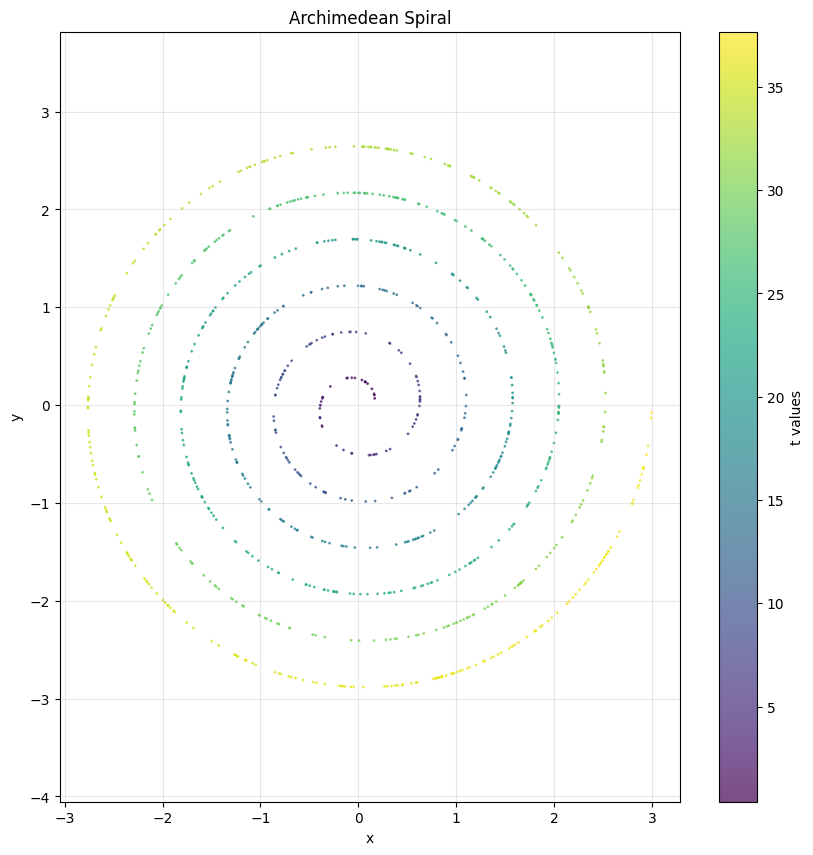

In [2]:
A = 1
B = 0.5
MAX_T = 2*np.pi * 6

def generate_spiral_point(a=A, b=B, t_max=MAX_T):
    """
    Generate n_points uniformly distributed along the spiral arc length
    For Archimedean spiral: r = a + b*t
    """
    # For uniform sampling along arc length, we need to solve for t values
    # Arc length element: ds = sqrt(r^2 + (dr/dt)^2) dt = sqrt((a+bt)^2 + b^2) dt
    
    # Use numerical integration to find arc length parameterization
    t_fine = np.linspace(0, t_max, 10000)
    r_fine = a + b * t_fine
    ds_dt = np.sqrt(r_fine**2 + b**2)
    
    # Cumulative arc length
    arc_lengths = np.zeros_like(t_fine)
    for i in range(1, len(t_fine)):
        arc_lengths[i] = arc_lengths[i-1] + ds_dt[i] * (t_fine[i] - t_fine[i-1])
    
    # Sample one point randomly along arc length
    random_arc = np.random.uniform(0, arc_lengths[-1])
    t_value = np.interp(random_arc, arc_lengths, t_fine)
    
    # Generate spiral point
    max_r = a + b * MAX_T
    r = (a + b * t_value ) / max_r * 3
    x = r * np.cos(t_value)
    y = r * np.sin(t_value)
    
    return x, y, t_value

# Generate and plot spiral points
points = [generate_spiral_point() for _ in range(1000)]
x, y, t_values = zip(*points)
x, y, t_values = np.array(x), np.array(y), np.array(t_values)

plt.figure(figsize=(10, 10))
plt.scatter(x, y, c=t_values, cmap='viridis', s=1, alpha=0.7)
plt.colorbar(label='t values')
plt.title('Archimedean Spiral')
plt.xlabel('x')
plt.ylabel('y')
plt.axis('equal')
plt.grid(True, alpha=0.3)
plt.show()

class SpiralDataset(torch.utils.data.Dataset):
    """
    Dataset that generates spiral points uniformly distributed along arc length
    """
    def __init__(self, n_points=1000, a=A, b=B, t_max=MAX_T):
        self.n_points = n_points
        self.a = a
        self.b = b
        self.t_max = t_max
        self.device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
    
    def __len__(self):
        return self.n_points
    
    def __getitem__(self, idx):
        # Generate a single spiral point
        x, y, _ = generate_spiral_point(self.a, self.b, self.t_max)
        point = torch.tensor([x, y], dtype=torch.float32).to(self.device)
        return point

def create_spiral_dataloader(n_points=1000, a=A, b=B, t_max=MAX_T, batch_size=64, shuffle=True):
    """
    Create a torch DataLoader for spiral points
    """
    dataset = SpiralDataset(n_points, a, b, t_max)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)
    return dataloader


# Circle dataloader

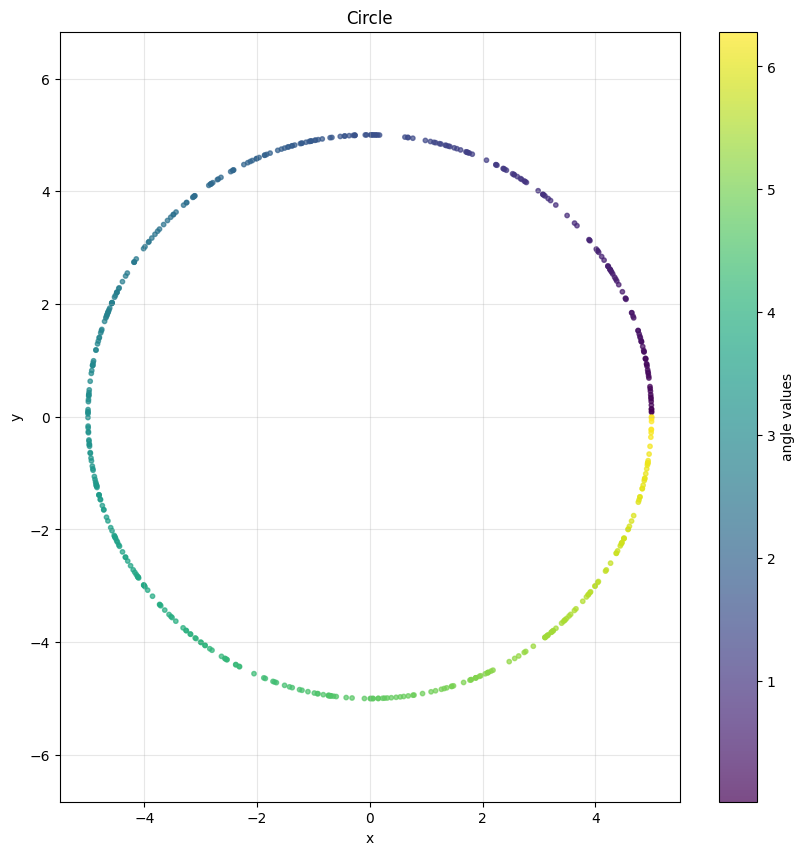

In [11]:

R = 5  # radius
MAX_T = 2*np.pi  # full circle

def generate_circle_points(n_points=1000, radius=R):
    """
    Generate n_points uniformly distributed along a circle
    """
    # Generate uniform random angles from 0 to 2π
    t_values = np.random.uniform(0, MAX_T, n_points)
    
    # Circle equations: x = r*cos(t), y = r*sin(t)
    x = radius * np.cos(t_values)
    y = radius * np.sin(t_values)
    
    return x, y, t_values

# Generate and plot circle points
x, y, t_values = generate_circle_points(n_points=500)

plt.figure(figsize=(10, 10))
plt.scatter(x, y, c=t_values, cmap='viridis', s=10, alpha=0.7)
plt.colorbar(label='angle values')
plt.title('Circle')
plt.xlabel('x')
plt.ylabel('y')
plt.axis('equal')
plt.grid(True, alpha=0.3)
plt.show()

class CircleDataset(torch.utils.data.Dataset):
    """
    Dataset that generates new circle points on each access
    """
    def __init__(self, n_points=1000, radius=R):
        self.n_points = n_points
        self.radius = radius
        self.device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
    
    def __len__(self):
        return self.n_points
    
    def __getitem__(self, idx):
        # Generate new circle points each time
        x, y, t_values = generate_circle_points(1, self.radius)
        point = torch.tensor([x[0], y[0]], dtype=torch.float32).to(self.device)
        return point

def create_circle_dataloader(n_points=1000, radius=R, batch_size=64, shuffle=True):
    """
    Create a torch DataLoader that generates new circle points for each batch
    """
    dataset = CircleDataset(n_points, radius)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)
    
    return dataloader



# HYPERPARAMETERS

In [20]:
SEED = 42
DDPM_T = 1000
LEARNING_RATE = 1e-3
DATASET_SIZE = 1024
BATCH_SIZE = 1024
VALIDATION_PRINT_EVERY = 10
VALIDATION_SIZE = 256
VALIDATION_BATCH_SIZE = VALIDATION_SIZE
CONVERGENCE_THRESHOLD = 1e-7
TRAINING_MAX_EPOCHS = 3000
DATASET = 'circle'

In [21]:
class VAEWithSteps(nn.Module):
    def __init__(self, steps, dimension=2, hidden_dim=64):
        super().__init__()
        self.steps = steps
        self.encoder = nn.Sequential(
            nn.Linear(dimension + 1, hidden_dim), # the 2d input and the t (time parameter)
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.RELU(),
            nn.Linear(hidden_dim, dimension),
        ) # return the mean and logvariance 

        self.decoder = nn.Sequential( # the 2d input and the t (time parameter)
            nn.Linear(dimension + 1, hidden_dim), 
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, dimension),
        ) # return the data point x 
    
    def forward_step(self, x, t):
        """
           Take a step in the forward process (i.e add noise)
           at step t=i x_i gives the parameters of the gaussian distribution
           where x_0 is the original data point
        """
        if t == 0:
            raise ValueError("t > 0")
        mu_t, logvar_t = self.encoder(torch.cat([x, t], dim=1))
        return mu_t, logvar_t

    
    def forward_process(self, x_0, T):
        """
        x_0 is a batch of 2d points 
        T is the number of steps you want to run the diffusion process
        """
        for i in range(T):
            x_i = self.encoder(torch.cat([x, i+1], dim=1))
        return x_i
    
    def reverse_step(self, x_t, t):
        if t == 0:
            raise ValueError("t > 0")
        mu_t_minus_1, logvar_t_minus_1 = self.decoder(torch.cat([x_t, t], dim=1))
        return mu_t_minus_1, logvar_t_minus_1
    
    def reverse_process(self, num_samples,T):
        f"""
        The reverse process is the decoding chain
        x_T is the standard normal gaussian 
        p(x_0, ... , x_T) = p(x_T)p(x_{T-1}|x_T) ... p(x_0|x_1)
        p(X_{T-1}|x_T) = N(X_{T-1}; µ_θ(x_T, t), Σ_θ(x_T, t))
        """
        for i in range(T+1):
            if i == 0:
                x_i = torch.randn_like((num_samples, 2)) 
            else:
                x_i = self.reverse_step(x_i, i)
        return x_i

    def loss_function(self, x):
        """ 
        x is a batch of 2d points 
        """
        random_t = torch.randint(0, self.steps, (x.shape[0],))

        # for every random timestep T , we need to do the
        # forward process and the reverse process

        # forward process
        
    
        

# My own (faulty) model

In [ ]:
LOG_2PI = math.log(2 * math.pi)
torch.autograd.set_detect_anomaly(True)

class DDPMModel(nn.Module):
    """
    Denoising Diffusion Probabilistic Model (DDPM) interface
    """
    
    def __init__(self, 
                 timesteps: int = 10,
                 beta_min: float = 1e-4,
                 beta_max: float = 0.02,
                 input_dim: int = 2,
                 hidden_dim: int = 128):
        """
        Args:
            timesteps: Number of diffusion steps T
            beta_start: Starting value of noise schedule
            beta_end: Ending value of noise schedule  
            input_dim: Dimensionality of input data
            hidden_dim: Hidden dimension for neural networks
        """
        super().__init__()
        self.num_timesteps = int(timesteps)
        self.T = self.num_timesteps
        self.beta_min = beta_min
        self.beta_max = beta_max
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim

        self.setup_model_parameters()
         
    @property
    def beta_t(self):
        """
        Linear interpolation from beta_min to beta_max over T timesteps
        """
        return torch.linspace(self.beta_min, self.beta_max, self.T)

    def setup_model_parameters(self):
        # Reverse Network architecture: input (x + timestep) -> hidden layer -> output (predicted noise/x_0)
        # Layer 1: Linear(input_dim + 1, hidden_dim) - takes concatenated x and timestep
        # Layer 2: ReLU activation
        # Layer 3: Linear(hidden_dim, input_dim) - outputs prediction in same space as input
        self.reverse_network_mu = nn.Sequential(
            nn.Linear(self.input_dim + 1, self.hidden_dim),
            nn.ReLU(),
            nn.Linear(self.hidden_dim, self.input_dim)
        )

        self.reverse_network_logvar = nn.Sequential(
            nn.Linear(self.input_dim + 1, self.hidden_dim),
            nn.ReLU(),
            nn.Linear(self.hidden_dim, self.input_dim),
        )

        
    # ==================== NOISE SCHEDULE ====================
    def get_noise_schedule_values(self):
        """
        Compute noise schedule values dynamically
        Returns alpha_t, alpha_bar_t, sqrt_alpha_bar_t, sqrt_one_minus_alpha_bar_t
        """
        alpha_t = 1.0 - self.beta_t
        alpha_bar_t = torch.cumprod(alpha_t, dim=0)
        sqrt_alpha_bar_t = torch.sqrt(alpha_bar_t)
        sqrt_one_minus_alpha_bar_t = torch.sqrt(1.0 - alpha_bar_t)
        
        return alpha_t, alpha_bar_t, sqrt_alpha_bar_t, sqrt_one_minus_alpha_bar_t


    # ==================== FORWARD PROCESS ====================
    def q_sample(self, x_0: torch.Tensor, t: int, noise: Optional[torch.Tensor] = None, return_all_diffusion_steps: bool = False) -> torch.Tensor:
        """
        Forward diffusion process: q(x_t | x_0)
        Directly sample x_t from x_0 using the reparameterization trick
        
        Args:
            x_0: Original data [batch_size, ...]
            t: Timestep [batch_size]
            noise: Optional pre-sampled noise
            
        Returns:
            x_t: Noised data at timestep t
        """
        # From the paper:
        # What distinguishes diffusion models from other types of latent variable models is that the approximate
        # posterior q(x1:T|x0), called the forward process or diffusion process, is fixed to a Markov chain that
        # gradually adds Gaussian noise to the data according to a variance schedule β1,...,βT:
        # q(x1:T|x0) := PI_t=1^T q(xt|xt−1), q(xt|xt−1) := N(xt; sqrt(1−βt )x_{t−1},β_t I)

        # for i in range(t):
        #     x_t = torch.randn_like(x_0) * torch.sqrt(1 - self.beta_t[i]) + torch.sqrt(self.beta_t[i]) * x_0
        _, alpha_bar_t, sqrt_alpha_bar_t, sqrt_one_minus_alpha_bar_t = self.get_noise_schedule_values()
        

        if return_all_diffusion_steps:
            # Parallelize by computing all timesteps at once (timesteps 1 to T)
            timesteps = torch.arange(1, t + 1, device=x_0.device)
            
            # Generate noise for all timesteps at once [timesteps, batch_size, input_dim]
            noise = torch.randn(len(timesteps), *x_0.shape, device=x_0.device)
            
            # Expand x_0 to match timesteps dimension [timesteps, batch_size, input_dim]
            x_0_expanded = x_0.unsqueeze(0).expand(len(timesteps), -1, -1)
            
            # Expand alpha_bars to match the shape [timesteps, 1, 1]
            
            # Compute all diffusion steps in parallel for timesteps 1 to T
            diffusion_steps = noise * sqrt_one_minus_alpha_bar_t.view(-1, 1, 1) + sqrt_alpha_bar_t.view(-1, 1, 1) * x_0_expanded
            
            # Include x_0 at timestep 0, then diffusion steps for timesteps 1 to T
            all_steps = torch.cat([x_0.unsqueeze(0), diffusion_steps], dim=0)
            
            return all_steps
        else:
            x_t = torch.randn_like(x_0) * sqrt_one_minus_alpha_bar_t[int(t)] + sqrt_alpha_bar_t[int(t)] * x_0
            return x_t

    
    def q_posterior_mean_variance(self, x_0: torch.Tensor, x_t: torch.Tensor, t: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Compute the true posterior q(x_{t-1} | x_t, x_0)
        i.e adding noise
        Used for computing the KL divergence loss term
        
        Returns:
            posterior_mean: Mean of q(x_{t-1} | x_t, x_0)
            posterior_variance: Variance of q(x_{t-1} | x_t, x_0)
        """
        
    
    # ==================== REVERSE PROCESS ====================
    def p_mean_variance(self, x_t: torch.Tensor, t: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Predict the mean and variance for p_θ(x_{t-1} | x_t)
        This is where your neural network prediction happens
        
        Args:
            x_t: Noisy data at timestep t
            t: Current timestep
            
        Returns:
            predicted_mean: μ_θ(x_t, t)
            predicted_variance: Σ_θ(x_t, t) or fixed variance
        """
        pass
    def p_sample(self, x_t: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Single reverse diffusion step: sample from p_θ(x_{t-1} | x_t)
        
        Args:
            x_t: Current noisy sample
            t: Current timestep
            
        Returns:
            x_{t-1}: Sample from previous timestep
        """
        # Check for NaN or infinite values in input
        if torch.isnan(x_t).any() or torch.isinf(x_t).any():
            print(f"Warning: NaN or inf detected in x_t at timestep {t}")
            x_t = torch.where(torch.isnan(x_t) | torch.isinf(x_t), torch.zeros_like(x_t), x_t)
        
        mu_estimate = self.reverse_network_mu(torch.cat([x_t, t.unsqueeze(0).unsqueeze(1).expand(x_t.shape[0], 1)], dim=1))
        # estimates the log of the variance - network output is softplused
        logvar_estimate_raw = self.reverse_network_logvar(torch.cat([x_t, t.unsqueeze(0).unsqueeze(1).expand(x_t.shape[0], 1)], dim=1))
        
        # More aggressive clamping to prevent numerical instability
        # Clamp logvar to prevent exp(logvar/2) from becoming too large or too small
        logvar_estimate = logvar_estimate_raw.clamp(min=-20.0, max=10.0)
        
        # Check for NaN in network outputs
        if torch.isnan(mu_estimate).any():
            print(f"Warning: NaN detected in mu_estimate at timestep {t}")
            mu_estimate = torch.where(torch.isnan(mu_estimate), torch.zeros_like(mu_estimate), mu_estimate)
        
        if torch.isnan(logvar_estimate).any():
            print(f"Warning: NaN detected in logvar_estimate at timestep {t}")
            logvar_estimate = torch.where(torch.isnan(logvar_estimate), torch.full_like(logvar_estimate, -10.0), logvar_estimate)
        
        # Reparametrization trick: x = mu + sigma * epsilon
        # where sigma = exp(0.5 * logvar) and epsilon ~ N(0, I)
        epsilon = torch.randn_like(mu_estimate)
        
        # Use more stable computation for sigma to avoid numerical issues
        # Instead of exp(0.5 * logvar), use exp(logvar/2) with additional safeguards
        half_logvar = 0.5 * logvar_estimate
        sigma = torch.exp(half_logvar)
        
        # Clamp sigma to prevent it from becoming too large and causing overflow
        sigma = sigma.clamp(max=10.0)
        
        # Special case: at timestep 0, don't add noise (deterministic)
        if t == 0:
            x_prev = mu_estimate
        else:
            x_prev = mu_estimate + sigma * epsilon
        
        print("t:", t, "logvar_estimate", logvar_estimate, "mu_estimate", mu_estimate, "sigma", sigma, "epsilon", epsilon, "x_prev[:10]", x_prev[:10])

        # Final safety check for output
        if torch.isnan(x_prev).any() or torch.isinf(x_prev).any():
            print(f"Warning: NaN or inf in output at timestep {t}")
            x_prev = torch.where(torch.isnan(x_prev) | torch.isinf(x_prev), mu_estimate, x_prev)
        
        return x_prev
    def p_log_pdf(self, x: torch.Tensor,  x_t: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Compute log(p_theta(x_t-1|x_t)) where p_theta(x_t-1|x_t)= N(x_t-1; mu_theta(x_t, t), sigma_theta(x_t, t))
        """
        mu_estimate = self.reverse_network_mu(torch.cat([x_t, t.unsqueeze(0).unsqueeze(1).expand(x_t.shape[0], 1)], dim=1))
        logvar_estimate_raw = self.reverse_network_logvar(torch.cat([x_t, t.unsqueeze(0).unsqueeze(1).expand(x_t.shape[0], 1)], dim=1))
        logvar_estimate = logvar_estimate_raw.clamp(min=-30.0, max=20.0)
        # Compute the pdf of the multivariate Gaussian for x_t
        # logvar_estimate contains log diagonal variances, so variance = exp(logvar_estimate)
        variance_raw = torch.exp(logvar_estimate)
        variance = variance_raw.clamp(min=1e-8)
        
        # For multivariate Gaussian with diagonal covariance:
        # p(x) = (2π)^(-k/2) * |Σ|^(-1/2) * exp(-0.5 * (x-μ)^T * Σ^(-1) * (x-μ))
        # where k is the dimension (2 in our case)
        
        k = x.shape[-1]  # dimension = 2
        
        # Log determinant of diagonal covariance matrix = sum of log variances
        log_det_cov = torch.sum(logvar_estimate, dim=-1)
        
        # Mahalanobis distance for diagonal covariance: sum of (x_i - mu_i)^2 / var_i
        diff = x - mu_estimate
        mahalanobis_sq = torch.sum((diff ** 2) / variance, dim=-1)
        
        # Log PDF = -k/2 * log(2π) - 0.5 * log|Σ| - 0.5 * mahalanobis^2
        log_pdf = -0.5 * k * LOG_2PI - 0.5 * log_det_cov - 0.5 * mahalanobis_sq
        return log_pdf
    
    def q_log_pdf(self, x_t: torch.Tensor, x_t_minus_1: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Compute log(q(x_t|x_t-1)) the pdf of the diffusion process for one step
        q(x_t|x_t-1) = N(x_t; sqrt(1-beta_t)x_t-1, beta_tI)
        """

        # Get beta_t for the current timestep
        beta_t = self.beta_t[int(t)-1]
        
        # Mean of the distribution: sqrt(1 - beta_t) * x_t-1
        mean = torch.sqrt(1 - beta_t).unsqueeze(-1) * x_t_minus_1
        
        # Variance is beta_t for diagonal covariance
        variance = beta_t.unsqueeze(-1).expand_as(x_t)
        
        # For multivariate Gaussian with diagonal covariance:
        # p(x) = (2π)^(-k/2) * |Σ|^(-1/2) * exp(-0.5 * (x-μ)^T * Σ^(-1) * (x-μ))
        
        k = x_t.shape[-1]  # dimension = 2
        
        # Log determinant of diagonal covariance matrix = sum of log variances
        log_det_cov = torch.sum(torch.log(variance), dim=-1)
        
        # Mahalanobis distance for diagonal covariance: sum of (x_i - mu_i)^2 / var_i
        diff = x_t - mean
        mahalanobis_sq = torch.sum((diff ** 2) / variance.clamp(min=1e-8), dim=-1)
        
        # Log PDF = -k/2 * log(2π) - 0.5 * log|Σ| - 0.5 * mahalanobis^2
        log_pdf = -0.5 * k * LOG_2PI - 0.5 * log_det_cov - 0.5 * mahalanobis_sq
        return log_pdf
    

    def p_sample_loop(self, shape: Tuple[int, ...], device: str = 'cpu') -> torch.Tensor:
        """
        Full reverse diffusion process: generate samples from pure noise
        
        Args:
            shape: Shape of samples to generate
            device: Device to run on
            
        Returns:
            Generated samples x_0
        """
        x_t = torch.randn(shape, device=device)
        for t in range(self.timesteps, 0, -1):
            x_t = self.p_sample(x_t, t)
        return x_t
    
    # ==================== NEURAL NETWORK PREDICTIONS ====================
    def predict_noise(self, x_t: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Neural network that predicts the noise ε added at timestep t
        This is the most common parameterization (ε-prediction)
        
        Args:
            x_t: Noisy input
            t: Timestep embedding
            
        Returns:
            predicted_noise: ε_θ(x_t, t)
        """
        pass
    
    def predict_x0(self, x_t: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Alternative parameterization: directly predict x_0
        
        Returns:
            predicted_x0: x̂_0 = f_θ(x_t, t)
        """
        pass
    
    def predict_v(self, x_t: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Alternative parameterization: predict v-parameter
        v = α_t * ε - σ_t * x_0 (used in some implementations)
        
        Returns:
            predicted_v: v_θ(x_t, t)
        """
        pass
    
    # ==================== LOSS FUNCTIONS ====================
    def loss_simple(self, x_0: torch.Tensor, t: torch.Tensor, noise: Optional[torch.Tensor] = None) -> torch.Tensor:
        """
        Simplified DDPM loss (most commonly used):
        L_simple = E_{t,x_0,ε}[||ε - ε_θ(√(ᾱ_t)x_0 + √(1-ᾱ_t)ε, t)||²]
        
        Args:
            x_0: Original clean data
            t: Random timestep
            noise: Optional pre-sampled noise
            
        Returns:
            MSE loss between true and predicted noise
        """
        pass
    
    def loss_vlb(self, x_0: torch.Tensor) -> torch.Tensor:
        """
        Variational Lower Bound loss (full ELBO):
        L_vlb = L_T + L_{T-1} + ... + L_1 + L_0
        where L_t = KL(q(x_{t-1}|x_t,x_0) || p_θ(x_{t-1}|x_t))
        
        More expensive but theoretically principled
        """
        pass
    
    def loss_hybrid(self, x_0: torch.Tensor, lambda_vlb: float = 0.001) -> torch.Tensor:
        """
        Hybrid loss combining simple and VLB losses:
        L_hybrid = L_simple + λ * L_vlb
        """
        pass

# ==================== TRAINING INTERFACE ====================
class DDPMTrainer:
    """
    Training wrapper for DDPM model
    """
    
    def __init__(self, model: DDPMModel, optimizer: torch.optim.Optimizer, device: str = 'cpu'):
        self.model = model
        self.optimizer = optimizer
        self.device = device
    
    # def train_step(self, batch: torch.Tensor) -> float:
    #     """
    #     Single training step
        
    #     Args:
    #         batch: Batch of clean data x_0
            
    #     Returns:
    #         Loss value
    #     """
    #     # batch will be x_0 (b, x, y) data points in a batch
    #     t = torch.randint(0, self.model.timesteps, (batch.shape[0],))
    #     self.model.q_sample(batch, t)
    #     epsilon = torch.randn_like(batch)
    #     # take graident descent step on epsilon - epsilon_theta(sqrt(alpha_bar_t)x_0 + sqrt(1-alpha_bar_t)epsilon, t)
    
    def loss_monte_carlo(self, batch: torch.Tensor) -> float:
        """
        Monte Carlo estimate of the loss function
        """
        # shape [T+1, B, D], include x_0 at index 0, x_T at -1
        x_t = self.model.q_sample(batch, self.model.T, return_all_diffusion_steps=True)
        x_T = x_t[-1] # [B, D]

        B = x_T.shape[0]
        D = x_T.shape[1]

        # as the array progresses you get more and more noisy
        # q is q(x_1:T|x_0) = PI_{t=1}^{T} q(x_t|x_{t-1})
        # where q(x_t|x_{t-1}) = N(x_t; sqrt(1-beta_t)x_{t-1}, beta_tI)

        # minimize the loss function monte carlo estimate
        # Compute the log probability of the terminal state
        # x_T ~ N(0, I) and x_T is 2 dimensional
        # compute log probability of x_T under standard normal distribution
        log_p_T = -0.5 * torch.sum(x_T**2, dim=-1) - 0.5 * D * LOG_2PI  # shape [B]
        
        # Compute the sum of log transition probabilities
        # prepare accumulation tensor on same device/dtype as log_p_T
        device = x_T.device
        dtype = x_T.dtype
        log_transitions = torch.zeros_like(log_p_T, device=device, dtype=dtype) # shape [B]

        for i in range(1, int(self.model.T)+1):
            t_tensor = torch.tensor(i, dtype=dtype, device=device)
            log_p_transition = self.model.p_log_pdf(x_t[i-1], x_t[i], t_tensor).clamp(min=-1e6, max=1e6)
            log_q_transition = self.model.q_log_pdf(x_t[i], x_t[i-1], t_tensor).clamp(min=-1e6, max=1e6)
            log_transitions = log_transitions + (log_p_transition - log_q_transition)
        
        L = - log_p_T - log_transitions # shape [B]

        # Average over the batch dimension (0th dimension)
        return torch.mean(L)
    def train_epoch(self, epoch, dataloader, print_every: int = 100) -> float:
        """
        Train for one epoch
        
        Returns:
            Average loss for the epoch
        """
        total_loss = 0.0  # Track cumulative loss for computing average
        num_batches = 0   # Track number of batches processed
        min_loss = float('inf')
        max_loss = float('-inf')
        
        for batch_idx, batch in enumerate(dataloader):
            # Clear gradients from previous iteration
            self.optimizer.zero_grad()
            
            # Compute Monte Carlo estimate of the loss functi
            # This computes L = -log p_T - sum of log transition ratios
            loss = self.loss_monte_carlo(batch)

            if not torch.isfinite(loss):
                print(f"Loss is not finite on batch {batch_idx}")
                break
            
            
            # Compute gradients of loss with respect to model parameters
            loss.backward()
            # Update model parameters using gradient descent to minimize loss
            self.optimizer.step()
            
            # Accumulate loss for average calculation
            loss_value = loss.item()
            total_loss += loss_value
            min_loss = min(min_loss, loss_value)
            max_loss = max(max_loss, loss_value)
            num_batches += 1
            

        
        # Return average loss across all batches in the epoch
        average_loss = total_loss / num_batches
        std_loss = ((total_loss**2 / num_batches) - average_loss**2)**0.5 if num_batches > 1 else 0.0
        print(f"Epoch {epoch} completed. Average loss: {average_loss:.6f}, Min loss: {min_loss:.6f}, Max loss: {max_loss:.6f}, Total batches: {num_batches}, Std loss: {std_loss:.6f}")
        return average_loss
    
    def sample(self, num_samples: int, sample_shape: Tuple[int, ...]) -> torch.Tensor:
        """
        Generate samples using the trained model
        """
        pass

# ==================== NETWORK ARCHITECTURES ====================
class TimeEmbedding(nn.Module):
    """
    Sinusoidal time embedding for timestep conditioning
    """
    def __init__(self, dim: int):
        super().__init__()
        
    def forward(self, t: torch.Tensor) -> torch.Tensor:
        """Convert timestep to sinusoidal embedding"""
        pass

class NoisePredictor(nn.Module):
    """
    Neural network for predicting noise ε_θ(x_t, t)
    For images, this would typically be a U-Net
    For simple data, this could be an MLP with time conditioning
    """
    def __init__(self, input_dim: int, hidden_dim: int, time_dim: int):
        super().__init__()
        
    def forward(self, x_t: torch.Tensor, t_emb: torch.Tensor) -> torch.Tensor:
        """
        Args:
            x_t: Noisy input
            t_emb: Time embedding
            
        Returns:
            Predicted noise
        """
        pass

# Train loop

In [ ]:
# Take a random 2D coordinate
# torch.manual_seed(SEED)  # For reproducibility

# model = DDPMModel(timesteps=DDPM_T)
# optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
# device = torch.device("mps" if torch.backends.mps.is_available() else "cuda" if torch.cuda.is_available() else "cpu")
# trainer = DDPMTrainer(model, optimizer, device)

# dataloader = create_spiral_dataloader(n_points=DATASET_SIZE, batch_size=BATCH_SIZE, shuffle=True)

# for epoch in range(N_EPOCHS):
#     train_loss = trainer.train_epoch(dataloader, print_every=BATCH_PRINT_EVERY)
#     print(f"Epoch {epoch+1} Train Loss: {train_loss:.6f}")


# Ummar Jamil's code

In [22]:
class DiffusionModel(nn.Module):
    def __init__(self, in_size, t_range):
        super().__init__()
        self.beta_small = 1e-4
        self.beta_large = 6e-2
        self.t_range = t_range # from 0 to T inclusive, 0 is the original image, T is unit noise
        self.T = t_range
        self.in_size = in_size
        self.device = 'mps'
        self.sequential = nn.Sequential(
            nn.Linear(in_size+1, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, in_size),
        ).to(self.device)
    
    def forward(self, x, t):
        # Expand t to match batch size and concatenate with x
        t_expanded = t.view(-1, 1).float()  # Shape: [batch, 1]
        x_with_t = torch.cat([x, t_expanded], dim=1)  # Shape: [batch, input_dim+1]
        # print(f"Forward pass, x {x}, t {t}, x_with_t {x_with_t}")
        return self.sequential(x_with_t)
    
    def beta(self, t):
        # Reminder q(x_t|x_0) = N(x_t; sqrt(alpha_bar_t * x_0, (1−alpha_bar_t)I )
        if t == 0:
            raise ValueError("t cannot be 0")
        return self.beta_small + ( t / self.t_range) * (self.beta_large - self.beta_small)
    
    def alpha(self, t):
        return 1 - self.beta(t)

    def alpha_bar(self, t):
        # product of alphas from 1 to t inclusive
        return math.prod(self.alpha(j) for j in range(1, t+1))
    
    def get_loss(self, batch, batch_idx, debug=False, override_t: int = None):
        """
        Corresponds to the Algorithm 1 from (Ho et al., 2020)
        """
        # get a random timestep for each image in the batch
        B, D = batch.shape
        if override_t is not None:
            ts = torch.tensor([override_t] * B, device=self.device)
        else:
            ts = torch.randint(1, self.t_range+1, [B], device=self.device)
        
        # generate noise, one for each image in the batch
        epsilons = torch.randn(B, D, device=self.device)
        
        # Vectorized computation instead of loop
        alpha_bars = torch.tensor([self.alpha_bar(t.item()) for t in ts], device=self.device)
        sqrt_alpha_bars = torch.sqrt(alpha_bars).view(-1, 1)
        sqrt_one_minus_alpha_bars = torch.sqrt(1 - alpha_bars).view(-1, 1)
        
        # Apply forward diffusion: x_t = sqrt(alpha_bar_t) * x_0 + sqrt(1 - alpha_bar_t) * epsilon
        noise_imgs = sqrt_alpha_bars * batch + sqrt_one_minus_alpha_bars * epsilons
        if debug:
            batch_np = batch.detach().cpu().numpy()
            noise_imgs_np = noise_imgs.detach().cpu().numpy()
            ts_np = ts.detach().cpu().numpy()
            plt.figure(figsize=(6,6))
            plt.scatter(batch_np[:,0], batch_np[:,1], color='blue', label='Original Batch', alpha=0.6)
            
            # Use viridis colormap to represent t values
            norm = plt.Normalize(1, self.t_range)  # Normalize between 1 and t_range
            cmap = plt.cm.viridis
            sc = plt.scatter(noise_imgs_np[:,0], noise_imgs_np[:,1], 
                           c=ts_np, cmap=cmap, norm=norm, 
                           label='Noised Images', alpha=0.8)
            
            plt.colorbar(sc, label='Timestep (t)')
            plt.legend()
            plt.title("Original vs Noised Batch Points")
            plt.xlabel("x[0]")
            plt.ylabel("x[1]")
            plt.show()

        # run the noise images through the model
        e_hat = self.forward(noise_imgs, ts)
        
        # calculate the loss, that is the MSE between the predicted noise and the actual noise
        loss = nn.functional.mse_loss(e_hat, epsilons, reduction='mean')
        return loss
    
    def training_step(self, batch, batch_idx, debug=False, override_t: int = None):
        # print(f"Training step, batch {batch}")
        loss = self.get_loss(batch, batch_idx, debug=debug, override_t=override_t)
        
        if not torch.isfinite(loss):
            print(f"Loss is not finite on batch {batch_idx}")
        return loss

    def denoise_sample(self, x, t: int):
        """
        Corrsponds to the inner loop of Algorithm 2 from (Ho et al., 2020)
        """
        with torch.no_grad():
            if t > 1:
                z = torch.randn(x.shape).to(self.device) 
            else:
                z = torch.zeros_like(x).to(self.device)
            
            B = x.shape[0]
            t_vecotor = torch.tensor([t] * B, device=self.device)
            e_hat = self.forward(x, t_vecotor)
            # print(f"e_hat: {e_hat.shape}, e_hat: {e_hat}")
            # perform the denoising step to take the image from t to t-1
            pre_scale = 1.0 / math.sqrt(self.alpha(t))
            # print(f"pre_scale: {pre_scale}")
            e_scale = (1 - self.alpha(t)) / math.sqrt(1 - self.alpha_bar(t))
            # print(f"e_scale: {e_scale}")
            post_sigma = math.sqrt(self.beta(t))
            # print(f"post_sigma: {post_sigma}")
            x_denoised = pre_scale * ( x - e_scale * e_hat) + post_sigma * z 
            return x_denoised, pre_scale, e_scale, e_hat, post_sigma
    
    def validation_step(self, batch, batch_idx):
        loss = self.get_loss(batch, batch_idx)
        #print(f'batch_idx: {batch_idx}, val/loss', loss.item())
        if not torch.isfinite(loss):
            print(f"Loss is not finite on validation batch {batch_idx}")
        return loss
    
    def parameters(self):
        """Return all trainable parameters of the model"""
        for param in self.sequential.parameters():
            yield param
    
    def configure_optimizers(self, lr=1e-3):
        optimizer = torch.optim.Adam(self.parameters(), lr=lr)
        return optimizer

    def train_epoch(self, epoch, dataloader, validation_dataloader, optimizer, print_every: int = 100, debug: bool = False, override_beta_large: float = None, override_beta_small: float = None, override_t: int = None) -> float:
        """
        Train for one epoch
        
        Returns:
            Average loss for the epoch
        """
        if override_beta_large is not None:
            self.beta_large = override_beta_large
        if override_beta_small is not None:
            self.beta_small = override_beta_small

        self.train()  # Set model to training mode
        
        total_loss = 0.0  # Track cumulative loss for computing average
        num_batches = 0   # Track number of batches processed
        min_loss = float('inf')
        max_loss = float('-inf')
        
        for batch_idx, batch in enumerate(dataloader):
            # Move batch to device
            batch = batch.to(self.device)
            
            # Clear gradients from previous iteration
            optimizer.zero_grad()

            loss = self.training_step(batch, batch_idx, debug=debug, override_t=override_t)
            # Compute gradients of loss with respect to model parameters
            loss.backward()
            
            # Apply gradient clipping to prevent exploding gradients
            # torch.nn.utils.clip_grad_norm_(self.parameters(), max_norm=1.0)
            
            # Update model parameters using gradient descent to minimize loss
            optimizer.step()
            # Accumulate loss for average calculation
            loss_value = loss.item()
            total_loss += loss_value
            min_loss = min(min_loss, loss_value)
            max_loss = max(max_loss, loss_value)
            num_batches += 1
        
        # Run validation every 10 epochs
        val_loss = None
        if epoch % VALIDATION_PRINT_EVERY == 0 and validation_dataloader is not None:
            self.eval()  # Set model to evaluation mode
            val_total_loss = 0.0
            val_num_batches = 0
            with torch.no_grad():
                for val_batch_idx, val_batch in enumerate(validation_dataloader):
                    val_batch = val_batch.to(self.device)
                    val_loss_step = self.validation_step(val_batch, val_batch_idx)
                    val_total_loss += val_loss_step.item()
                    val_num_batches += 1
            val_loss = val_total_loss / val_num_batches if val_num_batches > 0 else 0.0
        
        # Compute weight norm of the model
        weight_norm = 0.0
        for param in self.sequential.parameters():
            weight_norm += param.data.norm(2).item() ** 2
        weight_norm = weight_norm ** 0.5
        
        # Return average loss across all batches in the epoch
        average_loss = total_loss / num_batches
        std_loss = ((total_loss**2 / num_batches) - average_loss**2)**0.5 if num_batches > 1 else 0.0
        
        if val_loss is not None:
            print(f"Epoch {epoch} completed. Average loss: {average_loss:.6f}, Min loss: {min_loss:.6f}, Max loss: {max_loss:.6f}, Std loss: {std_loss:.6f}, Weight norm: {weight_norm:.6f}, Val loss: {val_loss:.6f}")
        else:
            print(f"Epoch {epoch} completed. Average loss: {average_loss:.6f}, Min loss: {min_loss:.6f}, Max loss: {max_loss:.6f}, Std loss: {std_loss:.6f}, Weight norm: {weight_norm:.6f}")
        return average_loss, min_loss, max_loss, weight_norm, val_loss

    
    def noise_sample(self, x: torch.Tensor, t: int) -> torch.Tensor:
        """
        Forward diffusion process: q(x_t+1 | x_t)
        
        Args:
            x: data at timestep t [batch_size, ]
            t: torch.Tensor  scalar
            
        Returns:
            x_t+1: Noised data at timestep t+1
        """
        beta = self.beta(t+1)

        epsilon = torch.randn_like(x)
        # N(x_t; sqrt(1-beta)x_t-1, beta I)
        x_t = math.sqrt(1-beta) * x + math.sqrt(beta) * epsilon
        return x_t

    def q_sample(self, x_0: torch.Tensor, t: int, noise: Optional[torch.Tensor] = None, return_all_diffusion_steps: bool = False) -> torch.Tensor:
        """
        Forward diffusion process: q(x_t | x_0)
        Directly sample x_t from x_0 using the reparameterization trick
        
        Args:
            x_0: Original data [batch_size, ...]
            t: Timestep [batch_size]
            noise: Optional pre-sampled noise
            
        Returns:
            x_t: Noised data at timestep t
        """
        # From the paper:
        # What distinguishes diffusion models from other types of latent variable models is that the approximate
        # posterior q(x1:T|x0), called the forward process or diffusion process, is fixed to a Markov chain that
        # gradually adds Gaussian noise to the data according to a variance schedule β1,...,βT:
        # q(x1:T|x0) := PI_t=1^T q(xt|xt−1), q(xt|xt−1) := N(xt; sqrt(1−βt )x_{t−1},β_t I)

        # for i in range(t):
        #     x_t = torch.randn_like(x_0) * torch.sqrt(1 - self.beta_t[i]) + torch.sqrt(self.beta_t[i]) * x_0
        alpha_bar_over_all_timesteps = torch.tensor([self.alpha_bar(i) for i in range(1, self.t_range+1)], device=x_0.device)
        sqrt_alpha_bar_over_all_timesteps = torch.sqrt(alpha_bar_over_all_timesteps)
        sqrt_one_minus_alpha_bar_over_all_timesteps = torch.sqrt(1 - alpha_bar_over_all_timesteps)
        

        if return_all_diffusion_steps:
            # Parallelize by computing all timesteps at once (timesteps 1 to T)
            timesteps = torch.arange(1, t + 1, device=x_0.device)
            
            # Generate noise for all timesteps at once [timesteps, batch_size, input_dim]
            noise = torch.randn(len(timesteps), *x_0.shape, device=x_0.device)
            
            # Expand x_0 to match timesteps dimension [timesteps, batch_size, input_dim]
            x_0_expanded = x_0.unsqueeze(0).expand(len(timesteps), -1, -1)
            
            # Expand alpha_bars to match the shape [timesteps, 1, 1]
            
            # Compute all diffusion steps in parallel for timesteps 1 to T
            diffusion_steps = noise * sqrt_one_minus_alpha_bar_over_all_timesteps.view(-1, 1, 1) + sqrt_alpha_bar_over_all_timesteps.view(-1, 1, 1) * x_0_expanded
            
            # Include x_0 at timestep 0, then diffusion steps for timesteps 1 to T
            all_steps = torch.cat([x_0.unsqueeze(0), diffusion_steps], dim=0)
            
            return all_steps
        else:
            x_t = torch.randn_like(x_0) * sqrt_one_minus_alpha_bar_over_all_timesteps[int(t)] + sqrt_alpha_bar_over_all_timesteps[int(t)] * x_0
            return x_t
    
    def bits_entropy(self, x_0: torch.Tensor):
        # compute D_KL(q(x_T|x_0)  || N(0,I))
        # where q(x_T|x_0) = N(x_T; mu = sqrt(alpha_bar_T)x_0, sigma^2 = (1-alpha_bar_T)I)
        alpha_bar_T = torch.tensor(self.alpha_bar(self.T), device=x_0.device)
        sqrt_one_minus_alpha_bar_T = torch.sqrt(1 - alpha_bar_T)
        sqrt_alpha_bar_T = torch.sqrt(alpha_bar_T)
        
        # KL divergence between two multivariate Gaussians:
        # D_KL(N(mu1, Sigma1) || N(mu2, Sigma2)) = 0.5 * [tr(Sigma2^-1 * Sigma1) + (mu2-mu1)^T * Sigma2^-1 * (mu2-mu1) - k + ln(det(Sigma2)/det(Sigma1))]
        # 
        # For our case:
        # q(x_T|x_0) = N(sqrt(alpha_bar_T)*x_0, (1-alpha_bar_T)*I)
        # p(x_T) = N(0, I)
        #
        # mu1 = sqrt(alpha_bar_T)*x_0, Sigma1 = (1-alpha_bar_T)*I
        # mu2 = 0, Sigma2 = I
        
        batch_size, dim = x_0.shape
        
        # mu1 - mu2 = sqrt(alpha_bar_T)*x_0 - 0 = sqrt(alpha_bar_T)*x_0
        mu_diff = sqrt_alpha_bar_T * x_0
        
        # Sigma2^-1 * Sigma1 = I^-1 * (1-alpha_bar_T)*I = (1-alpha_bar_T)*I
        # tr(Sigma2^-1 * Sigma1) = tr((1-alpha_bar_T)*I) = (1-alpha_bar_T) * dim
        trace_term = (1 - alpha_bar_T) * dim
        
        # (mu2-mu1)^T * Sigma2^-1 * (mu2-mu1) = mu_diff^T * I^-1 * mu_diff = ||mu_diff||^2
        quadratic_term = torch.sum(mu_diff ** 2, dim=1)  # Sum over dimensions for each batch element
        
        # ln(det(Sigma2)/det(Sigma1)) = ln(det(I)/det((1-alpha_bar_T)*I)) = ln(1/((1-alpha_bar_T)^dim)) = -dim*ln(1-alpha_bar_T)
        log_det_term = -dim * torch.log(1 - alpha_bar_T)
        
        # KL divergence
        kl_div = 0.5 * (trace_term + quadratic_term + log_det_term - dim)
        
        return kl_div.mean()


Training on circle dataset with 1024 points


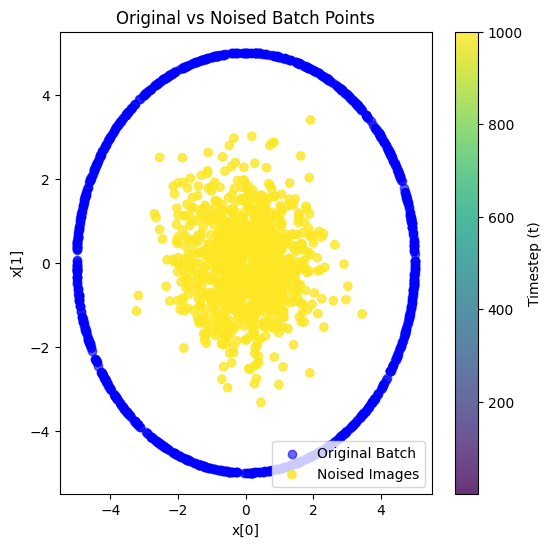

Epoch 0 completed. Average loss: 4.183518, Min loss: 4.183518, Max loss: 4.183518, Std loss: 0.000000, Weight norm: 32.860235, Val loss: 58.304741


In [23]:
# Take a random 2D coordinate
torch.manual_seed(SEED)  # For reproducibility
POINTS_TO_SHOW = 1000

model = DiffusionModel(in_size=2, t_range=DDPM_T)
optimizer = model.configure_optimizers(lr=LEARNING_RATE)

if DATASET == 'spiral':
    print(f"Training on spiral dataset with {DATASET_SIZE} points")
    dataloader = create_spiral_dataloader(n_points=POINTS_TO_SHOW, batch_size=POINTS_TO_SHOW, shuffle=True)
    val_dataloader = create_spiral_dataloader(n_points=VALIDATION_SIZE, batch_size=VALIDATION_BATCH_SIZE, shuffle=True)
elif DATASET == 'circle':
    print(f"Training on circle dataset with {DATASET_SIZE} points")
    dataloader = create_circle_dataloader(n_points=POINTS_TO_SHOW, batch_size=POINTS_TO_SHOW, shuffle=True)
    val_dataloader = create_circle_dataloader(n_points=VALIDATION_SIZE, batch_size=VALIDATION_BATCH_SIZE, shuffle=True)

for i in range(1):
    train_loss, min_loss, max_loss, weight_norm, val_loss = model.train_epoch(i, dataloader, val_dataloader, optimizer, debug=True, override_t=1000, override_beta_large=0.1, override_beta_small=0.00001)



Training on circle dataset with 1024 points


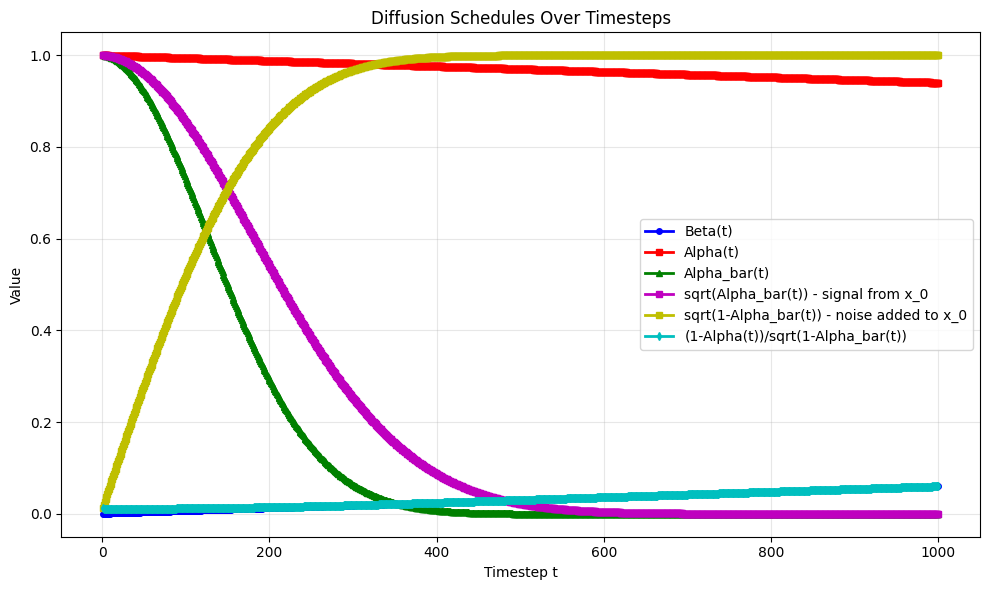

Loading from checkpoint: model_checkpoint_epoch_500.pt
Resuming training from epoch 501
Epoch 501 completed. Average loss: 0.972378, Min loss: 0.972378, Max loss: 0.972378, Std loss: 0.000000, Weight norm: 36.664508
Epoch 502 completed. Average loss: 0.939346, Min loss: 0.939346, Max loss: 0.939346, Std loss: 0.000000, Weight norm: 36.673897
Epoch 503 completed. Average loss: 1.085810, Min loss: 1.085810, Max loss: 1.085810, Std loss: 0.000000, Weight norm: 36.682849
Epoch 504 completed. Average loss: 1.051264, Min loss: 1.051264, Max loss: 1.051264, Std loss: 0.000000, Weight norm: 36.691780
Epoch 505 completed. Average loss: 1.121544, Min loss: 1.121544, Max loss: 1.121544, Std loss: 0.000000, Weight norm: 36.700757
Epoch 506 completed. Average loss: 1.043334, Min loss: 1.043334, Max loss: 1.043334, Std loss: 0.000000, Weight norm: 36.709455
Epoch 507 completed. Average loss: 0.990337, Min loss: 0.990337, Max loss: 0.990337, Std loss: 0.000000, Weight norm: 36.718027
Epoch 508 comple

ValueError: x and y must have same first dimension, but have shapes (3001,) and (2500,)

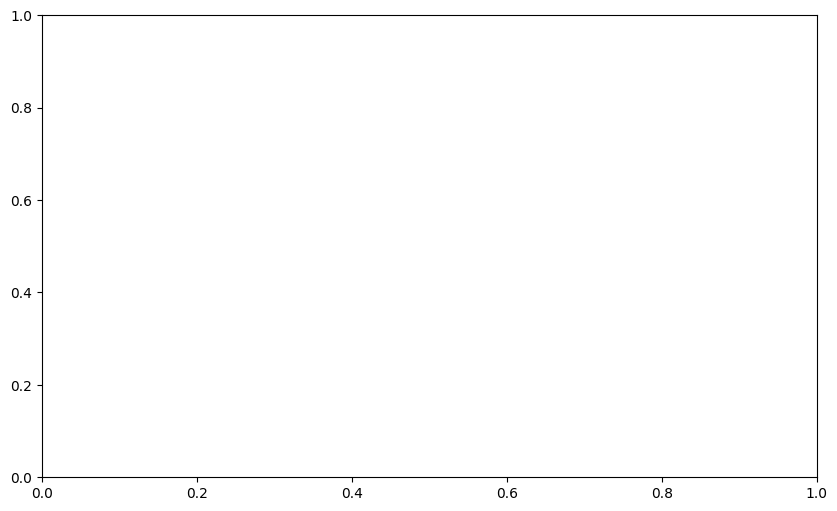

In [24]:
# Take a random 2D coordinate
torch.manual_seed(SEED)  # For reproducibility

model = DiffusionModel(in_size=2, t_range=DDPM_T)
optimizer = model.configure_optimizers(lr=LEARNING_RATE)

if DATASET == 'spiral':
    print(f"Training on spiral dataset with {DATASET_SIZE} points")
    dataloader = create_spiral_dataloader(n_points=DATASET_SIZE, batch_size=BATCH_SIZE, shuffle=True)
    val_dataloader = create_spiral_dataloader(n_points=VALIDATION_SIZE, batch_size=VALIDATION_BATCH_SIZE, shuffle=True)
elif DATASET == 'circle':
    print(f"Training on circle dataset with {DATASET_SIZE} points")
    dataloader = create_circle_dataloader(n_points=DATASET_SIZE, batch_size=BATCH_SIZE, shuffle=True)
    val_dataloader = create_circle_dataloader(n_points=VALIDATION_SIZE, batch_size=VALIDATION_BATCH_SIZE, shuffle=True)

# Plot beta values over timesteps
plt.figure(figsize=(10, 6))
timesteps = range(1, model.T + 1)
beta_values = [model.beta(i) for i in timesteps]
alpha_values = [model.alpha(i) for i in timesteps]
alpha_bar_values = [model.alpha_bar(i) for i in timesteps]
sqrt_alpha_bar_values = [math.sqrt(model.alpha_bar(i)) for i in timesteps]
sqrt_one_minus_alpha_bar_values = [math.sqrt(1 - model.alpha_bar(i)) for i in timesteps]
one_minus_alpha_over_sqrt_one_minus_alpha_bar_values = [(1 - model.alpha(i)) / math.sqrt(1 - model.alpha_bar(i)) for i in timesteps]

plt.plot(timesteps, beta_values, 'b-', linewidth=2, marker='o', markersize=4, label='Beta(t)')
plt.plot(timesteps, alpha_values, 'r-', linewidth=2, marker='s', markersize=4, label='Alpha(t)')
plt.plot(timesteps, alpha_bar_values, 'g-', linewidth=2, marker='^', markersize=4, label='Alpha_bar(t)')
plt.plot(timesteps, sqrt_alpha_bar_values, 'm-', linewidth=2, marker='s', markersize=4, label='sqrt(Alpha_bar(t)) - signal from x_0')
plt.plot(timesteps, sqrt_one_minus_alpha_bar_values, 'y-', linewidth=2, marker='s', markersize=4, label='sqrt(1-Alpha_bar(t)) - noise added to x_0')
plt.plot(timesteps, one_minus_alpha_over_sqrt_one_minus_alpha_bar_values, 'c-', linewidth=2, marker='d', markersize=4, label='(1-Alpha(t))/sqrt(1-Alpha_bar(t))')

plt.xlabel('Timestep t')
plt.ylabel('Value')
plt.title('Diffusion Schedules Over Timesteps')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# if DATASET == 'spiral':
#     x, y, t_values = generate_spiral_points(n_points=1000)
#     x_0 = torch.tensor(np.column_stack([x, y]), device='mps', dtype=torch.float32)
#     model.bits_entropy(x_0).mean()
# elif DATASET == 'circle':
#     x, y, t_values = generate_circle_points(n_points=1000)
#     x_0 = torch.tensor(np.column_stack([x, y]), device='mps', dtype=torch.float32)
#     model.bits_entropy(x_0).mean()


# train
losses = []
min_losses = []
max_losses = []
weight_norms = []
val_losses = []
epoch = 0
train_loss_prev = float('inf')
delta = float('inf')

# Check if there are any checkpoint files
checkpoint_files = [f for f in os.listdir() if f.startswith("model_checkpoint_epoch_") and f.endswith(".pt")]
if checkpoint_files:
    # Find the latest checkpoint
    latest_checkpoint = max(checkpoint_files, key=lambda x: int(x.split('_')[3].split('.')[0]))
    print(f"Loading from checkpoint: {latest_checkpoint}")
    checkpoint = torch.load(latest_checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch'] + 1  # Start from the next epoch
    train_loss_prev = checkpoint['loss']
    print(f"Resuming training from epoch {epoch}")

try:
    while delta > CONVERGENCE_THRESHOLD:
        if epoch > TRAINING_MAX_EPOCHS:
            break
        train_loss, min_loss, max_loss, weight_norm, val_loss = model.train_epoch(epoch, dataloader, val_dataloader, optimizer)
        delta = abs(train_loss - train_loss_prev)
        train_loss_prev = train_loss
        losses.append(train_loss)
        min_losses.append(min_loss)
        max_losses.append(max_loss)
        weight_norms.append(weight_norm)
        if val_loss is not None:
            val_losses.append(val_loss)
        
        # Save model checkpoint every 50 epochs
        if epoch % 50 == 0:
            checkpoint_path = f"model_checkpoint_epoch_{epoch}.pt"
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': train_loss,
            }, checkpoint_path)
            print(f"Checkpoint saved at epoch {epoch} to {checkpoint_path}")
        
        epoch += 1
except KeyboardInterrupt:
    print("Training interrupted! Saving checkpoint...")
    checkpoint_path = f"model_checkpoint_epoch_{epoch}_interrupted.pt"
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': train_loss_prev,
    }, checkpoint_path)
    print(f"Checkpoint saved to {checkpoint_path}")

# Plot loss over epochs
plt.figure(figsize=(10, 6))
plt.plot(range(1, epoch + 1), np.log(losses), 'b-', linewidth=2, marker='o', markersize=4)
plt.plot(range(1, epoch + 1), np.log(min_losses), 'r-', linewidth=2, marker='o', markersize=4)
plt.plot(range(1, epoch + 1), np.log(max_losses), 'g-', linewidth=2, marker='o', markersize=4)
plt.plot(range(1, epoch + 1), np.log(weight_norms), 'y-', linewidth=2, marker='o', markersize=4)
if val_losses:  # Only plot if we have validation losses
    val_x_coords = [i * VALIDATION_PRINT_EVERY for i in range(len(val_losses))]
    plt.plot(val_x_coords, np.log(val_losses), 'c-', linewidth=2, marker='o', markersize=4)
plt.xlabel('Epoch')
plt.ylabel('LOG Training Loss')
plt.title('LOG Loss Over Epochs')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [98]:
checkpoint_files = [f for f in os.listdir() if f.startswith("model_checkpoint_epoch_") and f.endswith(".pt")]
print(checkpoint_files)

['model_checkpoint_epoch_100.pt', 'model_checkpoint_epoch_150.pt', 'model_checkpoint_epoch_650.pt', 'model_checkpoint_epoch_700.pt', 'model_checkpoint_epoch_0.pt', 'model_checkpoint_epoch_1000.pt', 'model_checkpoint_epoch_600.pt', 'model_checkpoint_epoch_750.pt', 'model_checkpoint_epoch_50.pt', 'model_checkpoint_epoch_500.pt', 'model_checkpoint_epoch_450.pt', 'model_checkpoint_epoch_900.pt', 'model_checkpoint_epoch_850.pt', 'model_checkpoint_epoch_950.pt', 'model_checkpoint_epoch_800.pt', 'model_checkpoint_epoch_550.pt', 'model_checkpoint_epoch_400.pt', 'model_checkpoint_epoch_300.pt', 'model_checkpoint_epoch_250.pt', 'model_checkpoint_epoch_350.pt', 'model_checkpoint_epoch_200.pt']


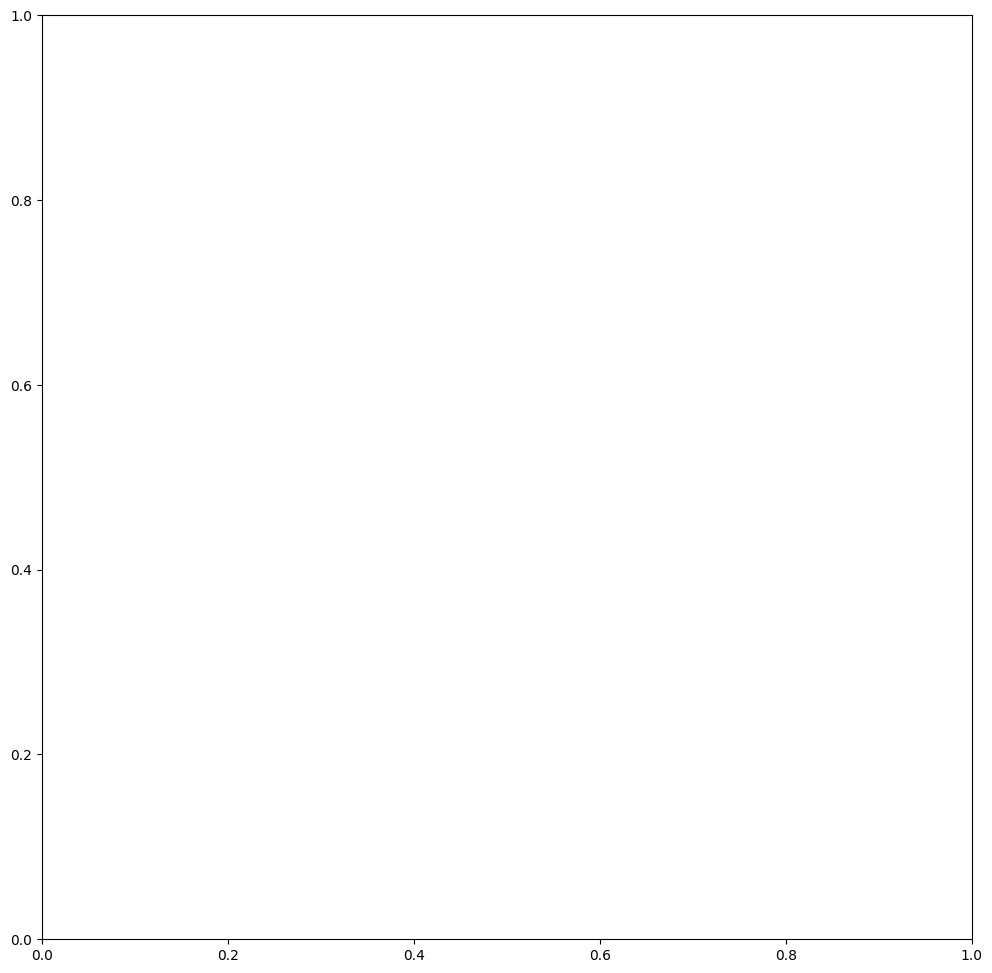

In [14]:
import matplotlib.animation as animation
from IPython.display import HTML

# Collect all batches
all_batches = []
for epoch in range(10):
    for batch in dataloader:
        all_batches.append(batch.cpu().detach().numpy())

# Create animation
fig, ax = plt.subplots(figsize=(12, 12))

def animate(frame):
    ax.clear()
    batch = all_batches[frame]
    ax.scatter(batch[:, 0], batch[:, 1], alpha=0.6, s=20)
    if DATASET == 'spiral':
        ax.set_xlim(-90, 90)
        ax.set_ylim(-90, 90)
    elif DATASET == 'circle':
        ax.set_xlim(-5, 5)
        ax.set_ylim(-5, 5)
    ax.set_title(f'Batch {frame + 1}/{len(all_batches)} - {batch.shape[0]} points')
    ax.grid(True, alpha=0.3)

ani = animation.FuncAnimation(fig, animate, frames=len(all_batches), interval=500, repeat=True)
plt.show()

# Display as HTML for Jupyter
HTML(ani.to_jshtml())

# Single point diffusion statistics

Original points: [[-1.4515669  4.784658 ]
 [ 4.5685606  2.0318103]
 [ 3.0671291 -3.9487617]
 [ 4.22703   -2.6706214]
 [ 2.1444376 -4.5167894]
 [ 4.5640397  2.041946 ]
 [-4.545263   2.0834074]
 [-4.458735   2.2626712]
 [ 1.8588567  4.6416216]
 [-1.824019  -4.655422 ]
 [-4.8693185 -1.1356659]
 [-3.3191824  3.7393887]
 [ 4.762612   1.5223436]
 [-4.2871695 -2.5729706]
 [ 1.6597866 -4.716472 ]
 [-1.7909145 -4.668257 ]
 [ 1.6002424 -4.7370057]
 [-3.075428  -3.9423018]
 [-3.6170464  3.4520974]
 [ 4.2848234 -2.5768757]]


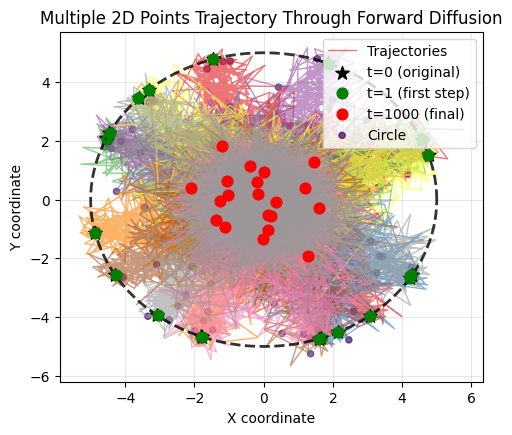

In [15]:

# === RUN FORWARD DIFFUSION PROCESS ===
# Run forward diffusion process for all timesteps
# get multiple random points from spiral

n_points = 20  # Number of points to sample from spiral

if DATASET == 'spiral':
    x, y, t_values = generate_spiral_point(n_points=n_points)
    x_0_points = torch.tensor(np.column_stack([x, y]), device='mps', dtype=torch.float32)
elif DATASET == 'circle':
    x, y, t_values = generate_circle_points(n_points=n_points)
    x_0_points = torch.tensor(np.column_stack([x, y]), device='mps', dtype=torch.float32)

print(f"Original points: {x_0_points.cpu().detach().numpy()}")

# Run diffusion for all points
all_diffusion_trajectories = []
for i in range(n_points):
    # Pass a single point with batch dimension [1, 2] instead of [2]
    x_0_single = x_0_points[i].unsqueeze(0)  # Shape: [1, 2]
    x_t = model.q_sample(x_0_single, model.T, return_all_diffusion_steps=True)  # x_t is a tensor of shape (timesteps+1, 1, 2)
    all_diffusion_trajectories.append(x_t.squeeze().cpu().detach().numpy())

# Convert to numpy arrays for plotting
timesteps = list(range(model.T+1))
# Create visualization
plt.figure(figsize=(12, 10))

# Plot 1: Trajectory of multiple points through diffusion
plt.subplot(2, 2, 1)
colors = plt.cm.Set1(np.linspace(0, 1, n_points))

for i, (trajectory, color) in enumerate(zip(all_diffusion_trajectories, colors)):
    plt.plot(trajectory[:, 0], trajectory[:, 1], '-', alpha=0.6, linewidth=1, color=color)
    plt.scatter(trajectory[0, 0], trajectory[0, 1], c='black', s=100, marker='*', zorder=5)
    plt.scatter(trajectory[1, 0], trajectory[1, 1], c='green', s=60, zorder=5)
    plt.scatter(trajectory[-1, 0], trajectory[-1, 1], c='red', s=60, zorder=5)
    # Add every 50th point for trajectory visualization
    color_indices = np.arange(0, len(trajectory[::50]))
    plt.scatter(trajectory[::50, 0], trajectory[::50, 1], c=color_indices, s=20, alpha=0.7, cmap='viridis')

# Draw the spiral r = A + B * t (Archimedean spiral)
if DATASET == 'spiral':
    t_spiral = np.linspace(0, MAX_T, 1000)
    r_spiral = A + B * t_spiral
    x_spiral = r_spiral * np.cos(t_spiral)
    y_spiral = r_spiral * np.sin(t_spiral)
    plt.plot(x_spiral, y_spiral, 'k--', alpha=0.8, linewidth=2, label='Spiral r = A + B*t')
elif DATASET == 'circle':
    t_circle = np.linspace(0, 2*np.pi, 1000)
    x_circle = R * np.cos(t_circle)
    y_circle = R * np.sin(t_circle)
    plt.plot(x_circle, y_circle, 'k--', alpha=0.8, linewidth=2, label='Circle r = R')

plt.xlabel('X coordinate')
plt.ylabel('Y coordinate')
plt.title('Multiple 2D Points Trajectory Through Forward Diffusion')
plt.legend(['Trajectories', 't=0 (original)', 't=1 (first step)', f't={model.T} (final)', 'Spiral' if DATASET == 'spiral' else 'Circle'])
plt.grid(True, alpha=0.3)

# # Plot 2: X coordinate over time
# plt.subplot(2, 2, 2)
# plt.plot(timesteps, noisy_points[:, 0], 'r-', linewidth=2)
# plt.axhline(y=x_0.cpu().detach().numpy()[0], color='black', linestyle='--', alpha=0.7, label='Original X')
# plt.xlabel('Timestep t')
# plt.ylabel('X coordinate')
# plt.title('X Coordinate vs Timestep')
# plt.legend()
# plt.grid(True, alpha=0.3)

# # Plot 3: Y coordinate over time
# plt.subplot(2, 2, 3)
# plt.plot(timesteps, noisy_points[:, 1], 'b-', linewidth=2)
# plt.axhline(y=x_0.cpu().detach().numpy()[1], color='black', linestyle='--', alpha=0.7, label='Original Y')
# plt.xlabel('Timestep t')
# plt.ylabel('Y coordinate')
# plt.title('Y Coordinate vs Timestep')
# plt.legend()
# plt.grid(True, alpha=0.3)

# # Plot 4: Distance from origin over time
# distances = np.sqrt(noisy_points[:, 0]**2 + noisy_points[:, 1]**2)
# original_distance = np.sqrt(x_0.cpu().detach().numpy()[0]**2 + x_0.cpu().detach().numpy()[1]**2)
# plt.subplot(2, 2, 4)
# plt.plot(timesteps, distances, 'purple', linewidth=2)
# plt.axhline(y=original_distance, color='black', linestyle='--', alpha=0.7, label='Original distance')
# plt.xlabel('Timestep t')
# plt.ylabel('Distance from origin')
# plt.title('Distance from Origin vs Timestep')
# plt.legend()
# plt.grid(True, alpha=0.3)

# plt.tight_layout()
# plt.show()


# # # Print some key statistics
# print(f"Original distance from origin: {original_distance.item():.4f}")
# print(f"Final distance from origin: {distances[-1]:.4f}")
# print(f"Maximum distance reached: {np.max(distances):.4f}")

# Dataset diffusion progress

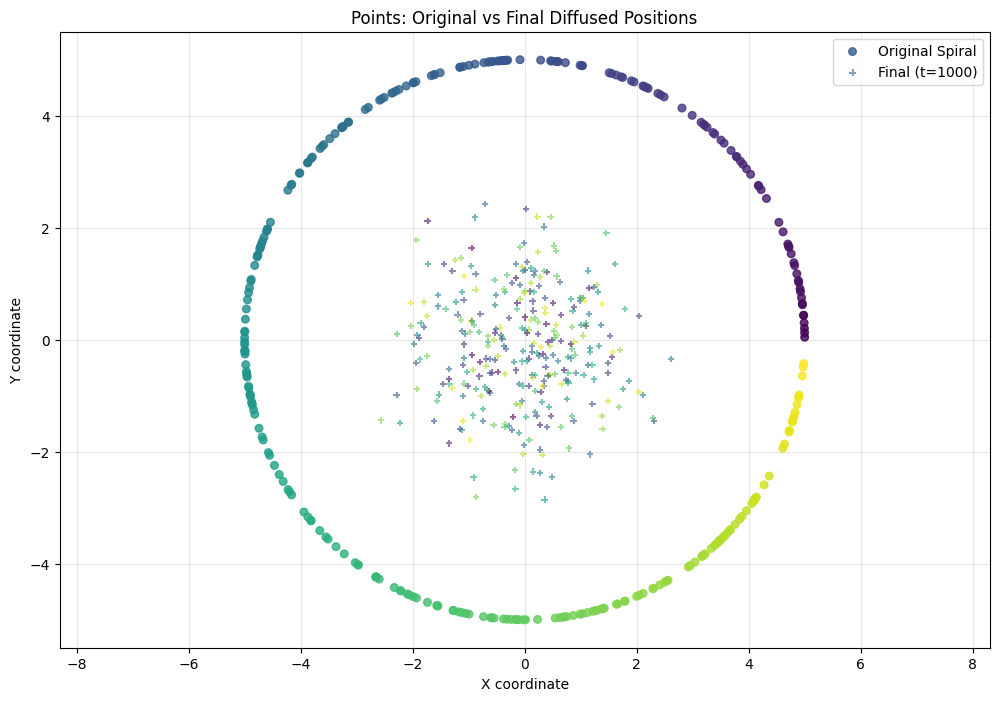

Visualized diffusion process from original to final timestep 1000


NameError: name 'spiral_points' is not defined

In [18]:

def generate_spiral_points_tensor(n_points=100, a=A, b=B, t_max=MAX_T):
    # Generate multiple spiral points by creating an array of t values
    t = np.linspace(0, t_max, n_points)
    # Calculate radius at each t
    max_t = A + B * t_max
    r = (a + b * t) / max_t * 3
    # Calculate x and y coordinates for each t
    x = r * np.cos(t)
    y = r * np.sin(t)
    return np.column_stack([x, y]), t

def generate_circle_points_tensor(n_points=100, radius=R):
    x, y, t = generate_circle_points(n_points=n_points, radius=radius)
    return np.column_stack([x, y]), t

# Generate spiral points
if DATASET == 'spiral':
    spiral_points, spiral_t = generate_spiral_points_tensor(n_points=300)
    spiral_points = torch.tensor(spiral_points, dtype=torch.float32)
elif DATASET == 'circle':
    circle_points, circle_t = generate_circle_points_tensor(n_points=300)
    circle_points = torch.tensor(circle_points, dtype=torch.float32)

if DATASET == 'spiral':
    points = spiral_points
    t = spiral_t
elif DATASET == 'circle':
    points = circle_points
    t = circle_t

# 2. Run forward diffusion process for model.T steps using model.q_sample
# Store trajectories for each point
trajectories = []
for i in range(points.shape[0]):
    # Get single point and reshape for model.q_sample
    single_point = points[i].unsqueeze(0)  # Shape: (1, 2)
    
    # Apply forward diffusion to get all timesteps
    point_trajectory = model.q_sample(single_point, model.T, return_all_diffusion_steps=True)
    # point_trajectory shape: (timesteps+1, 1, 2)
    
    # Convert to numpy and squeeze for plotting
    trajectory_numpy = point_trajectory.squeeze().detach().numpy()  # Shape: (timesteps+1, 2)
    trajectories.append(trajectory_numpy)

# Convert trajectories to proper format for plotting
timesteps = list(range(model.T + 1))

# Create colors based on spiral parameter t
colors = plt.cm.viridis(t / np.max(t))

# 3. Plot the trajectory of the points through diffusion
plt.figure(figsize=(12, 8))

# Plot original spiral with colors based on t parameter
plt.scatter(points[:, 0], points[:, 1], c=colors, s=30, alpha=0.8, label='Original Spiral', zorder=5)

# Plot final diffused points with same colors as their original positions
final_points = np.array([trajectory[-1] for trajectory in trajectories])
plt.scatter(final_points[:, 0], final_points[:, 1], c=colors, s=20, alpha=0.6, marker='+', label=f'Final (t={model.T})', zorder=4)

plt.xlabel('X coordinate')
plt.ylabel('Y coordinate')
plt.title('Points: Original vs Final Diffused Positions')
plt.legend()
plt.grid(True, alpha=0.3)
plt.axis('equal')
plt.show()

print(f"Visualized diffusion process from original to final timestep {model.T}")
print(f"Each of the {spiral_points.shape[0]} points shows its original and final position")


# From Gaussian points to reverse diffusion process

Processing timestep 999, average norm: 0.01870761439204216, largest x_t magnitude: 3.119049072265625
Processing timestep 998, average norm: 0.018686389550566673, largest x_t magnitude: 3.206345319747925
Processing timestep 997, average norm: 0.01860993355512619, largest x_t magnitude: 3.3317484855651855
Processing timestep 996, average norm: 0.018593743443489075, largest x_t magnitude: 3.143413543701172
Processing timestep 995, average norm: 0.018510615453124046, largest x_t magnitude: 3.511364698410034
Processing timestep 994, average norm: 0.018527522683143616, largest x_t magnitude: 3.787501096725464
Processing timestep 993, average norm: 0.018488900735974312, largest x_t magnitude: 3.6121912002563477
Processing timestep 992, average norm: 0.01847316510975361, largest x_t magnitude: 3.6057307720184326
Processing timestep 991, average norm: 0.018405146896839142, largest x_t magnitude: 3.8418009281158447
Processing timestep 990, average norm: 0.018429212272167206, largest x_t magnitud

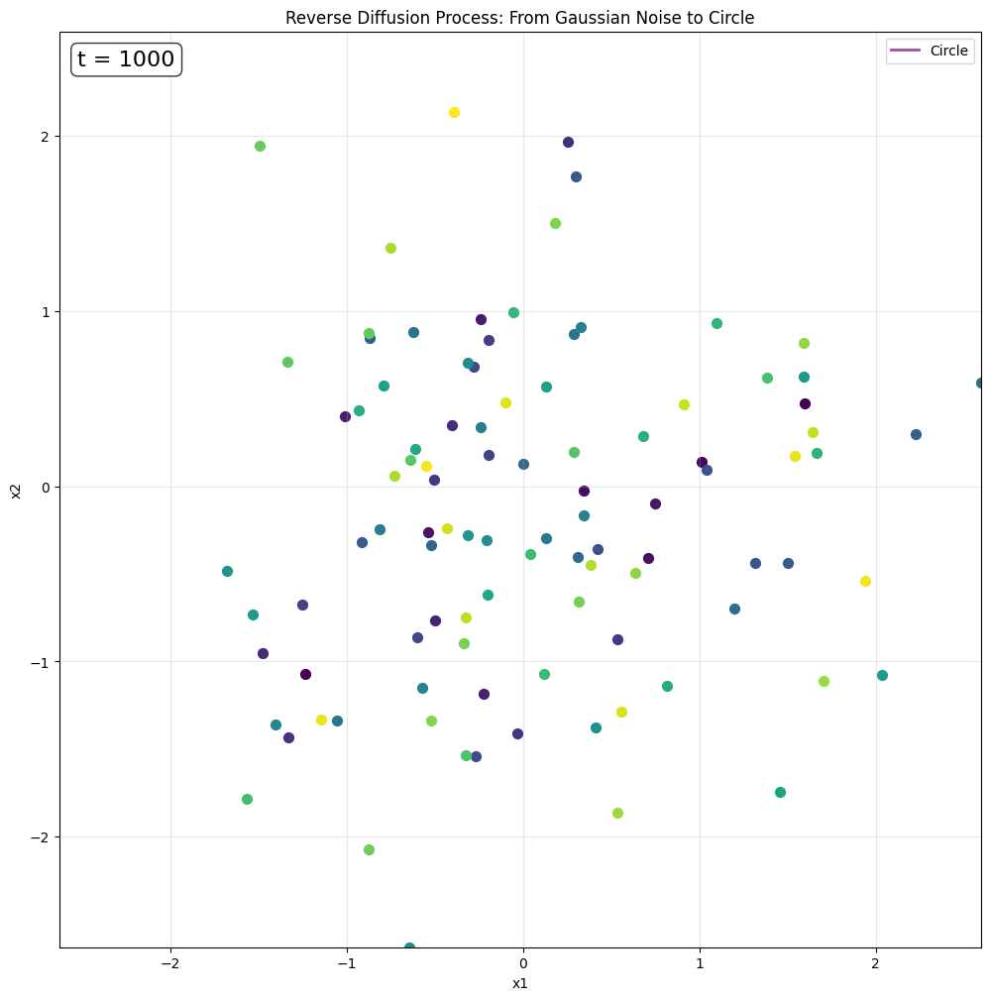

In [17]:
# Generate Gaussian points
NUM_SIMULATED_POINTS = 100
# Generate points from a normal distribution with mean 0 and std 90 (so 1 std dev covers radius -90 to 90)
x_0 = torch.randn(NUM_SIMULATED_POINTS, 2, device='mps')

# Store values for plotting
pre_scale_values = []
post_sigma_values = []
e_scale_values = []
e_hat_values = []  # Store the e_hat
intermediate_x_t_values = []
timesteps = []

# Create consistent colors for each point
colors = plt.cm.viridis(np.linspace(0, 1, NUM_SIMULATED_POINTS))

x_t = x_0
# Store initial state
intermediate_x_t_values.append(x_t.cpu().detach().numpy())
timesteps.append(model.T)

# apply the reverse diffusion process
for t in range(model.T, 0, -1): # from T to 1 in reverse order inclusive
    # x = pre_scale * ( x - e_scale * e_hat) + post_sigma * z
    x_t, pre_scale, e_scale, e_hat, post_sigma = model.denoise_sample(x_t, t)
    print(f"Processing timestep {t-1}, average norm: {np.linalg.norm(e_scale  * e_hat.cpu().detach().numpy(), axis=1).mean()}, largest x_t magnitude: {np.max(np.linalg.norm(x_t.cpu().detach().numpy(), axis=1))}")
    
    # Store values for plotting
    timesteps.append(t-1)
    intermediate_x_t_values.append(x_t.cpu().detach().numpy())
    pre_scale_values.append(pre_scale)
    post_sigma_values.append(post_sigma)
    e_scale_values.append(e_scale)
    e_hat_values.append(e_hat.cpu().detach().numpy())


# Set up the figure and axis
fig, ax = plt.subplots(figsize=(12, 12))

if DATASET == 'spiral':
    # Draw the Archimedean spiral: r = A + B * T
    t_spiral = np.linspace(0, MAX_T, 1000)
    t_max = A + B * MAX_T
    r_spiral = (A + B * t_spiral) / t_max * 3
    x_spiral = r_spiral * np.cos(t_spiral)
    y_spiral = r_spiral * np.sin(t_spiral)
elif DATASET == 'circle':
    t_circle = np.linspace(0, 2*np.pi, 1000)
    x_circle = R * np.cos(t_circle)
    y_circle = R * np.sin(t_circle)


def animate(frame):
    ax.clear()
    
    # Draw the spiral background
    if DATASET == 'spiral':
        ax.plot(x_spiral, y_spiral, 'purple', linewidth=2, alpha=0.7, label='Archimedean Spiral')
    elif DATASET == 'circle':
        ax.plot(x_circle, y_circle, 'purple', linewidth=2, alpha=0.7, label='Circle')
    
    # Get current timestep (show every 10 timesteps)
    timestep_index = frame * 20
    if timestep_index >= len(timesteps):
        timestep_index = len(timesteps) - 1
    current_t = timesteps[timestep_index]
    
    # Plot current points with consistent colors
    current_points = intermediate_x_t_values[timestep_index]
    for i in range(NUM_SIMULATED_POINTS):
        ax.scatter(current_points[i, 0], current_points[i, 1], alpha=1.0, s=50, color=colors[i])
    
    # Add a single label for the legend
    #ax.scatter([], [], alpha=1.0, s=50, color='red', label=f'Points at t={current_t}')
    # Add timestep text in top left
    ax.text(0.02, 0.98, f't = {current_t}', transform=ax.transAxes, fontsize=16, 
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    ax.set_xlabel('x1')
    ax.set_ylabel('x2')
    ax.set_title('Reverse Diffusion Process: From Gaussian Noise to Spiral' if DATASET == 'spiral' else 'Reverse Diffusion Process: From Gaussian Noise to Circle')
    ax.grid(True, alpha=0.3)
    ax.legend()

    xy_min = min(min(current_points[:, 0]), min(current_points[:, 1]))
    xy_max = max(max(current_points[:, 0]), max(current_points[:, 1]))
    
    ax.set_xlim(xy_min, xy_max)
    ax.set_ylim(xy_min, xy_max)


# Create animation (show every 10 timesteps)
num_frames = (len(intermediate_x_t_values) + 19) // 20  # Round up division
anim = animation.FuncAnimation(fig, animate, frames=num_frames, interval=100, blit=False)

# Display animation
#plt.show()
HTML(anim.to_jshtml())
# Plot intermediate x_t points and visualize the denoising components
# For visualization, we'll show a subset of points to avoid clutter
# num_points_to_show = min(100, NUM_SIMULATED_POINTS)
# point_indices = np.linspace(0, NUM_SIMULATED_POINTS-1, num_points_to_show, dtype=int)

# print("Length of intermediate_x_t_values: ", len(intermediate_x_t_values))

# # Plot trajectories of selected points through the reverse diffusion process
# for i, point_idx in enumerate(point_indices):
#     trajectory = [intermediate_x_t_values[step][point_idx] for step in range(len(intermediate_x_t_values))]
#     trajectory = np.array(trajectory)
    
#     for j in range(len(trajectory) - 1):
#         alpha = 0.5
#         plt.arrow(trajectory[j, 0], trajectory[j, 1], 
#                  trajectory[j+1, 0] - trajectory[j, 0], trajectory[j+1, 1] - trajectory[j, 1],
#                  head_width=0.02, head_length=0.02, fc='orange', ec='orange', alpha=alpha, linewidth=1)


# For the last few timesteps, show the denoising vector components
# This visualizes: x_{t-1} = pre_scale * (x_t - e_scale * e_hat) + post_sigma * z
# for step_idx in range(min(3, len(intermediate_x_t_values))):  # Show last 3 steps
#     if step_idx < len(intermediate_x_t_values) - 1:
#         current_x = intermediate_x_t_values[step_idx + 1]  # x_t
#         next_x = intermediate_x_t_values[step_idx]  # x_{t-1}
        
#         # Show denoising vectors for a few sample points
#         for point_idx in point_indices[:5]:  # Show vectors for first 5 points only
#             start_point = current_x[point_idx]
#             end_point = next_x[point_idx]
            
#             # Plot the denoising step as an arrow
#             plt.arrow(start_point[0], start_point[1], 
#                      end_point[0] - start_point[0], end_point[1] - start_point[1],
#                      head_width=0.05, head_length=0.05, fc='green', ec='green', alpha=0.6)
# for each timestep, use the stored arrays pre_scale_values, e_scale_values, e_hat_values, post_sigma_values

# plt.xlabel('x1')
# plt.ylabel('x2')
# plt.title('2D Gaussian Distribution vs Final x_t after Reverse Diffusion')
# plt.grid(True, alpha=0.3)
# plt.axis('equal')
# plt.legend()

# plt.tight_layout()
# plt.show()
# Plot post_sigma, e_scale, and beta values at every step
# fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(12, 10))

# # Plot post_sigma
# ax1.plot(timesteps, post_sigma_values, 'b-', marker='o', markersize=4)
# ax1.set_xlabel('Timestep t')
# ax1.set_ylabel('post_sigma')
# ax1.set_title('post_sigma at Each Reverse Diffusion Step')
# ax1.grid(True, alpha=0.3)

# # Plot e_scale
# ax2.plot(timesteps, e_scale_values, 'g-', marker='s', markersize=4)
# ax2.set_xlabel('Timestep t')
# ax2.set_ylabel('e_scale')
# ax2.set_title('e_scale at Each Reverse Diffusion Step')
# ax2.grid(True, alpha=0.3)

# ax3.plot(timesteps, pre_scale_values, 'r-', marker='o', markersize=4)
# ax3.set_xlabel('Timestep t')
# ax3.set_ylabel('pre_scale')
# ax3.set_title('pre_scale at Each Reverse Diffusion Step')
# ax3.grid(True, alpha=0.3)

# plt.tight_layout()
# plt.show()

# print(x_t.shape)
# print(x_t[:10])


In [ ]:

# Set the animation embed limit to allow larger animations
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 500  # Set to 500


def vector_field_params(model, x_t, t):
    """
    x_t is in R^2
    t is an integer between 1 and model.T inclusive
    model.denoise_sample(x_t, t) returns:
    x_t, pre_scale, e_scale, e_hat, post_sigma

    the e_hat is the score i.e the vector field value which is a 2d vector at point x_t
    for time t
    """
    x_denoised, pre_scale, e_scale, e_hat, post_sigma = model.denoise_sample(x_t, t)
    return x_denoised, pre_scale, e_scale, e_hat, post_sigma

def vector_field_at_time(model, meshgrid_X, meshgrid_Y, t, ax=None, fig=None, show_grid=True, normalize=False):
    # Get vector field at current timestep
    grid_points = np.stack([meshgrid_X.flatten(), meshgrid_Y.flatten()], axis=1)
    grid_points_tensor = torch.tensor(grid_points, dtype=torch.float32, device='mps')
    _, pre_scale, e_scale, e_hat, _ = vector_field_params(model, grid_points_tensor, t)
    
    e_hat_np = - e_hat.cpu().detach().numpy() * e_scale * pre_scale 

    if normalize:
        # Calculate norms before normalization for coloring
        original_norms = np.linalg.norm(e_hat_np, axis=1, keepdims=True)
        # Normalize vectors to unit size
        norms = np.where(original_norms == 0, 1e-8, original_norms)  # Avoid division by zero
        e_hat_np = e_hat_np / norms
    
    # Reshape back to grid format
    U = e_hat_np[:, 0].reshape(meshgrid_X.shape)
    V = e_hat_np[:, 1].reshape(meshgrid_Y.shape)
    # Reshape norms for coloring with more extreme scaling
    #C = original_norms.flatten().reshape(X.shape)
    # Apply power scaling to make the colorscale more extreme
    #C = np.power(C, 2)  # Square the values to make differences more pronounced
    
    # Create new quiver plot with color based on vector magnitude
    quiver = ax.quiver(meshgrid_X, meshgrid_Y, U, V, alpha=1.0, color='red', 
                      width=0.005, headwidth=3, headlength=3, headaxislength=3, 
                      scale=15, scale_units='width', pivot='mid')
    # Add colorbar to show the magnitude scale
    # cbar = plt.colorbar(quiver, ax=ax, shrink=0.8)
    
    ax.set_xlim(meshgrid_X.min(), meshgrid_X.max())
    ax.set_ylim(meshgrid_Y.min(), meshgrid_Y.max())
    ax.set_xlabel('x1')
    ax.set_ylabel('x2')
    if show_grid:
        ax.grid(True, alpha=0.5)
        # Set major grid lines spacing to follow the meshgrid
        ax.set_xticks(meshgrid_X[0, :])  # Use the x values from the first row of meshgrid
        ax.set_yticks(meshgrid_Y[:, 0])  # Use the y values from the first column of meshgrid
    ax.set_aspect('equal')
    ax.legend()
    
    # Update title and t value
    ax.set_title(f'Vector Field at timestep t={t}', fontsize=14)
    ax.text(0.02, 0.98, f't = {t}', transform=ax.transAxes, ha='left', va='top', 
            fontsize=12, fontweight='bold', bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.9))
    
    return quiver,
        
def vector_field_at_frame(frame):
    # from high T (noise) to low T (signal)
    if frame <= 40: # till 20
        t = model.T - frame * 40 # 2000 to 2000 - 40 * 40 = 400
    elif frame <= 60: # till 60
        t = 400 - (frame - 40) * 15  # 400 - 15 = 385 to 400 - 15 * 20 = 100
    else:  # < 80
        t = 100 - (frame - 60) * 5

    
    # Get vector field at current timestep
    return vector_field_at_time(model, grid_points_tensor, t)

def vector_field_animation(model):
    # Plot the Gaussian distribution and the final x_t points on the same axes
    # Create a grid of points for the vector field
    # Set up the figure and axis
    fig, ax = plt.subplots(figsize=(16, 16))

    if DATASET == 'spiral':
        # Draw the Archimedean spiral: r = A + B * T
        t_spiral = np.linspace(0, MAX_T, 1000)
        r_spiral = A + B * t_spiral
        x_spiral = r_spiral * np.cos(t_spiral)
        y_spiral = r_spiral * np.sin(t_spiral)
        ax.plot(x_spiral, y_spiral, 'purple', linewidth=2, alpha=0.7, label='Archimedean Spiral')
    elif DATASET == 'circle':
        t_circle = np.linspace(0, 2*np.pi, 1000)
        x_circle = R * np.cos(t_circle)
        y_circle = R * np.sin(t_circle)
        ax.plot(x_circle, y_circle, 'purple', linewidth=2, alpha=0.7, label='Circle')
    # Initialize quiver plot
    quiver = ax.quiver(X, Y, np.zeros_like(X), np.zeros_like(Y), scale=50, alpha=0.7, color='red')
    title_text = ax.text(0.5, 0.95, '', transform=ax.transAxes, ha='center', fontsize=14)
    # Add prominent t value display for current frame
    t_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, ha='left', va='top', 
                    fontsize=24, fontweight='bold', bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.9))

    ax.set_xlim(-10, 10)
    ax.set_ylim(-10, 10)
    ax.set_xlabel('x1')
    ax.set_ylabel('x2')
    ax.grid(True, alpha=0.3)
    ax.set_aspect('equal')
    ax.legend()

    # Create animation - show every 10th timestep
    # FuncAnimation arguments explained:
    # - fig: the figure object to animate on
    # - vector_field_at_frame: function called for each frame, receives frame number as argument
    #   (frame values will be passed automatically by FuncAnimation: 0, 1, 2, ..., frames-1)
    # - frames: total number of frames in animation (model.T//100 = number of timesteps divided by 100)
    # - interval: delay between frames in milliseconds (200ms = 0.2 seconds per frame)
    # - blit: if True, only redraws changed parts for better performance (False here since we clear/redraw everything)
    # - repeat: if True, animation loops continuously when it reaches the end
    anim = animation.FuncAnimation(fig, vector_field_at_frame, frames=model.T//25, interval=150, blit=False, repeat=True)

    # Display the animation
    #plt.show()
    HTML(anim.to_jshtml())


def draw_vector_field_at_time(model, t, show_spiral=True, show_grid=True, x_range=(-10, 10, 19), y_range=(-10, 10, 19), normalize=False):
    # Plot the Gaussian distribution and the final x_t points on the same axes
    # Create a grid of points for the vector field
    x_linspace = np.linspace(x_range[0], x_range[1], x_range[2])
    y_linspace = np.linspace(y_range[0], y_range[1], y_range[2])
    X, Y = np.meshgrid(x_linspace, y_linspace)

    # Set up the figure and axis
    fig, ax = plt.subplots(figsize=(16, 16))

    if show_spiral:
        if DATASET == 'spiral':
            # Draw the Archimedean spiral: r = A + B * T
            t_spiral = np.linspace(0, MAX_T, 1000)
            max_t = A + B * MAX_T
            r_spiral = (A + B * t_spiral) / max_t * 3
            x_spiral = r_spiral * np.cos(t_spiral)
            y_spiral = r_spiral * np.sin(t_spiral)
            ax.plot(x_spiral, y_spiral, 'purple', linewidth=2, alpha=0.7, label='Archimedean Spiral')
        elif DATASET == 'circle':
            t_circle = np.linspace(0, 2*np.pi, 1000)
            x_circle = R * np.cos(t_circle)
            y_circle = R * np.sin(t_circle)
            ax.plot(x_circle, y_circle, 'purple', linewidth=2, alpha=0.7, label='Circle')

    # Get vector field at current timestep
    quiver = vector_field_at_time(model, X, Y, t, ax=ax, fig=fig, show_grid=show_grid, normalize=normalize)
    plt.show()


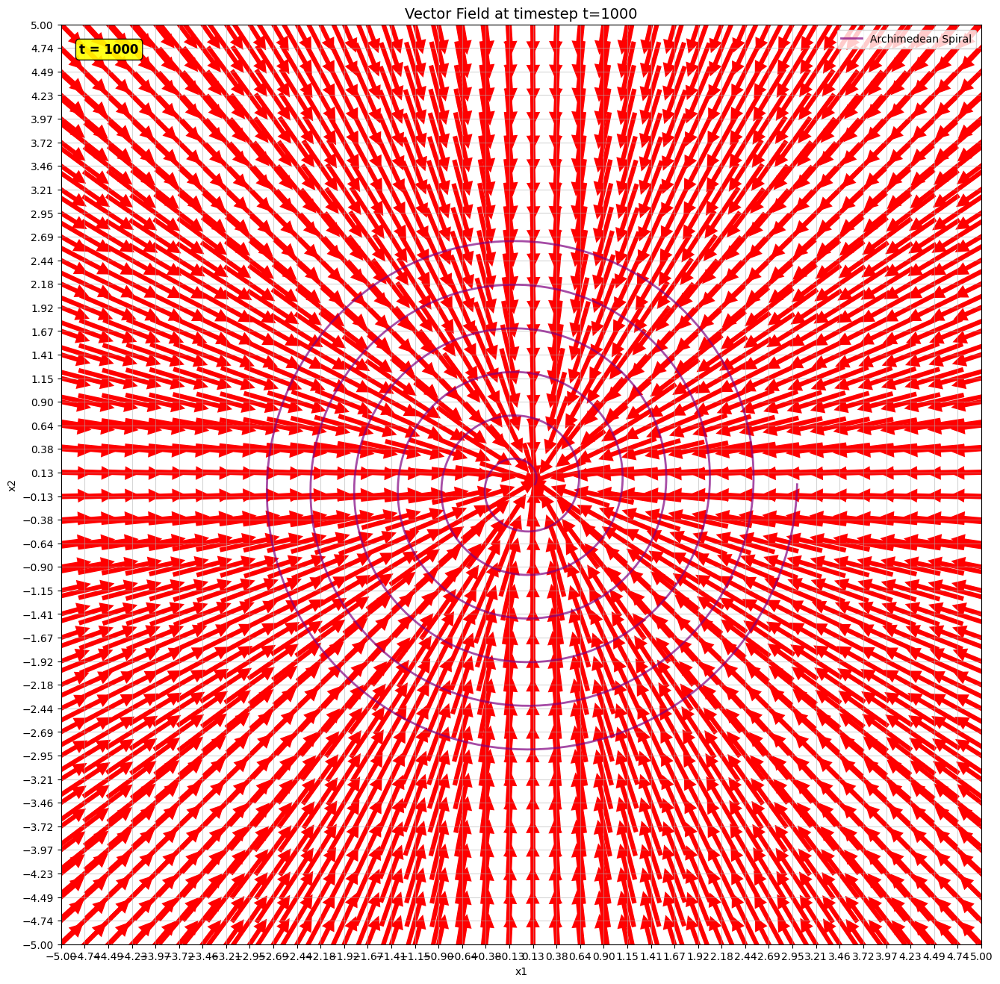

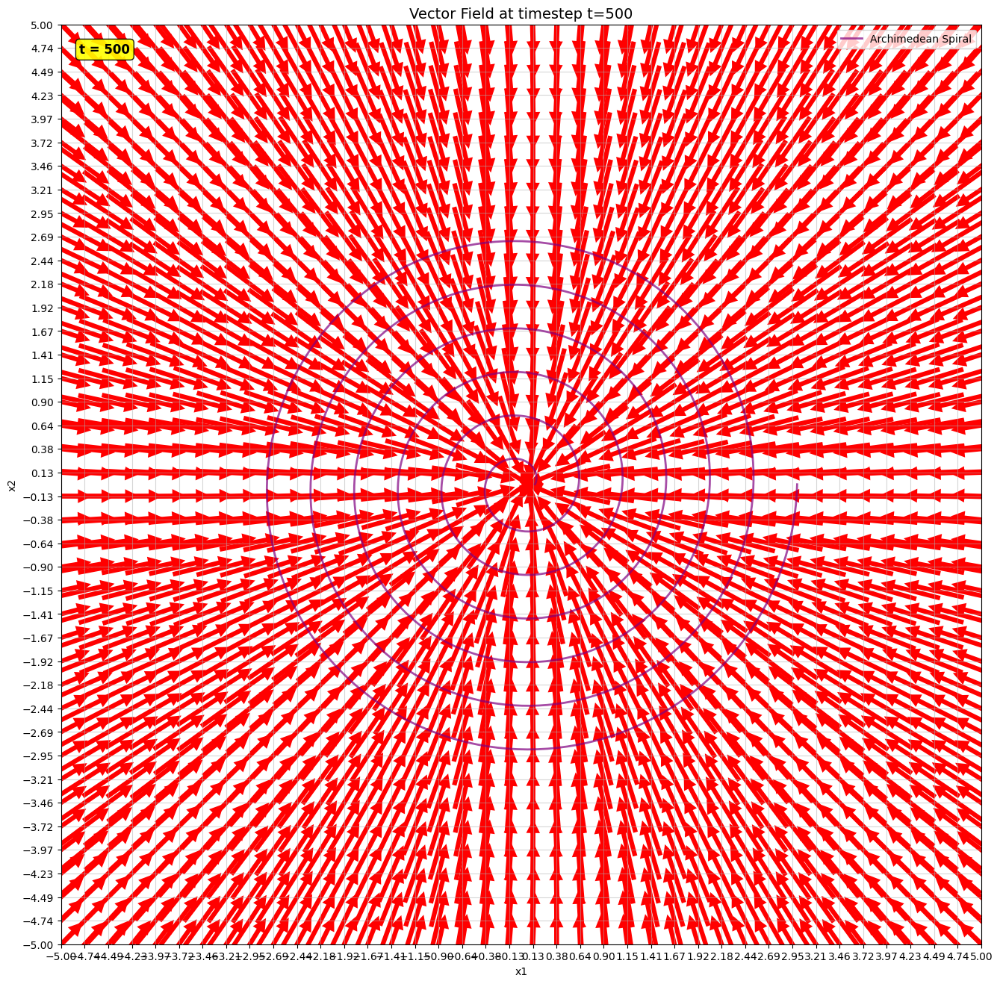

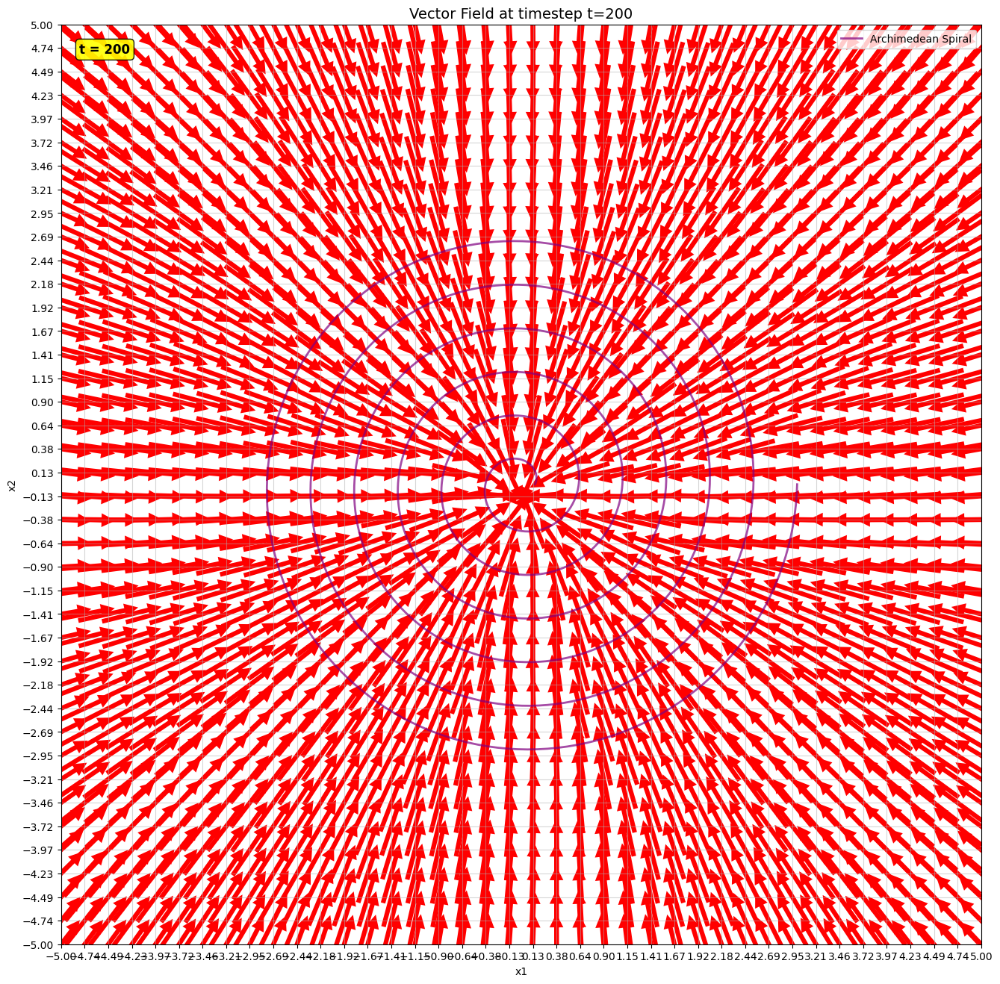

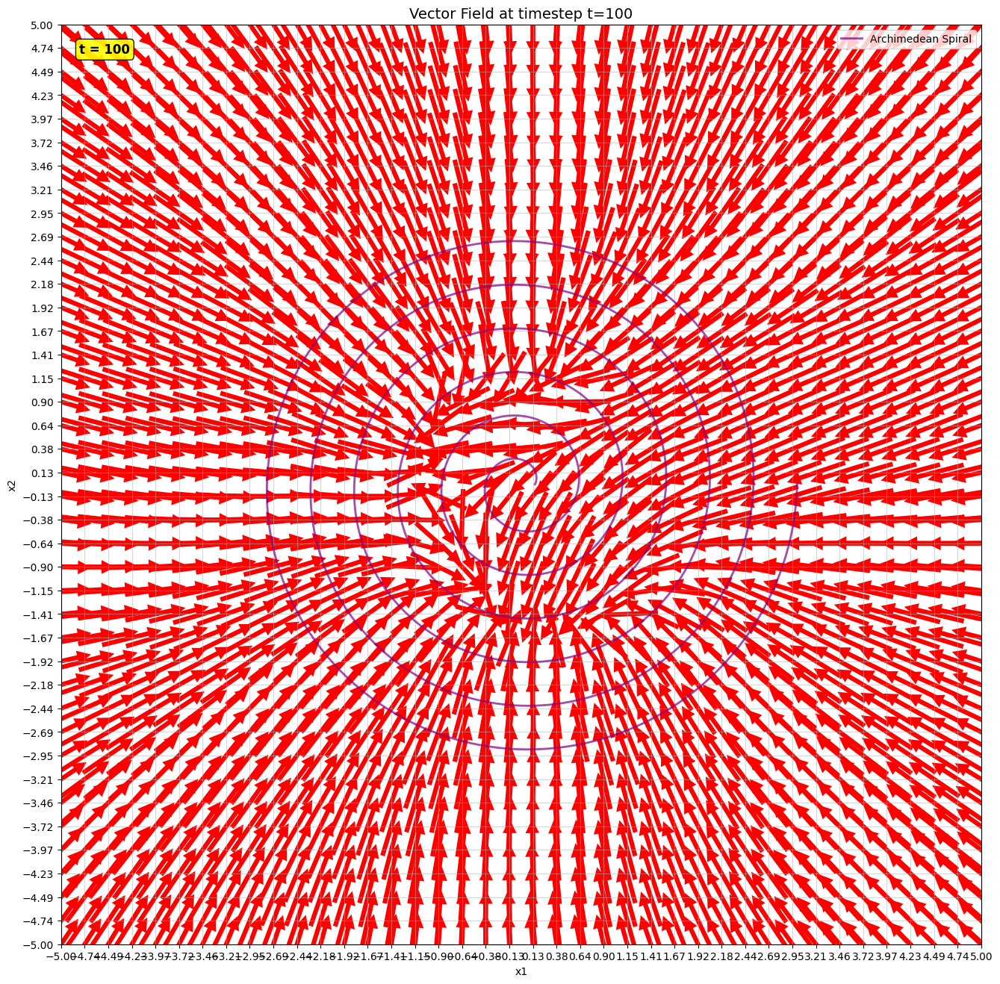

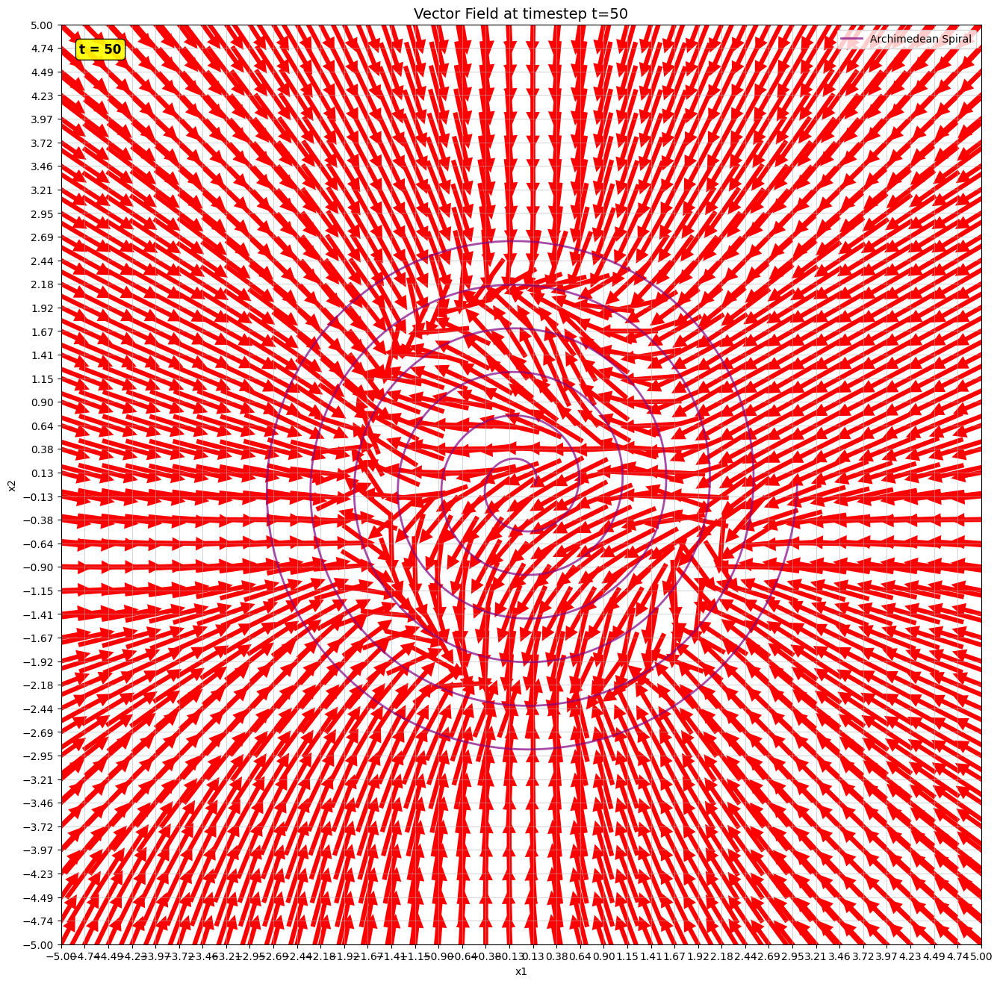

...

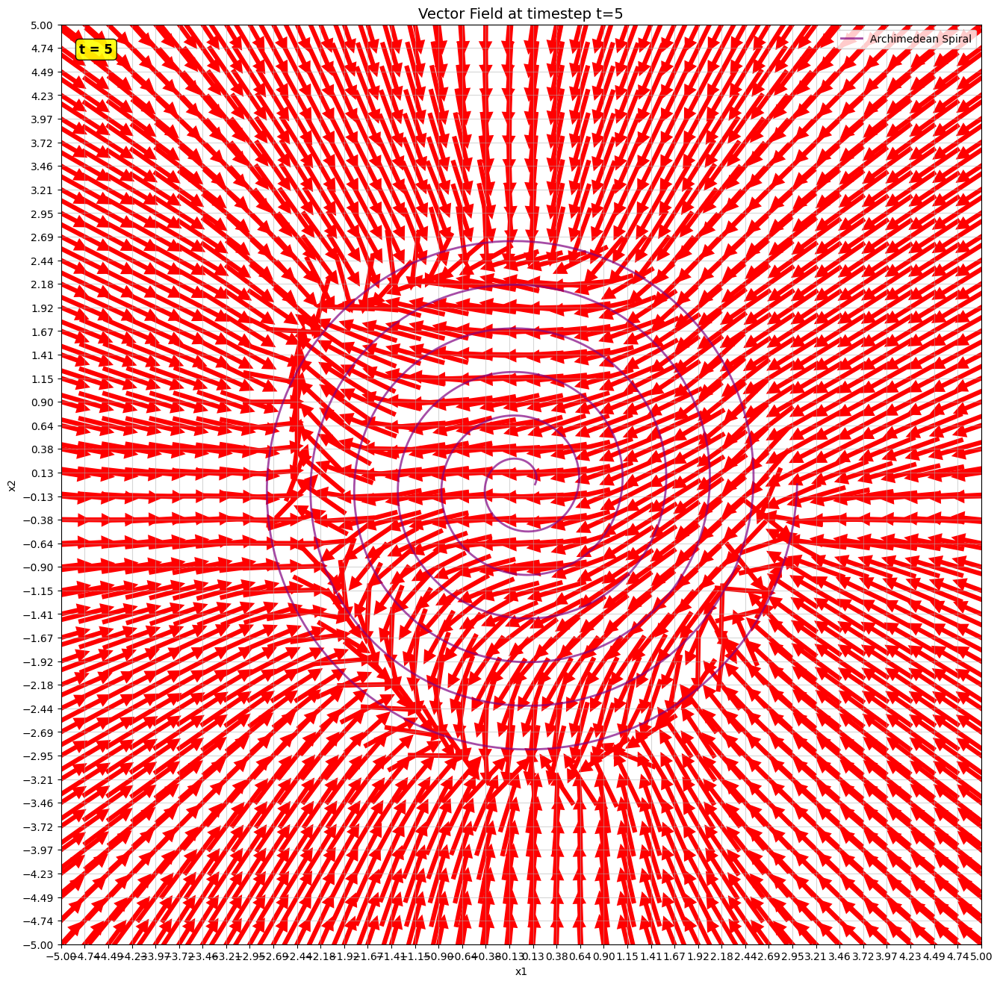

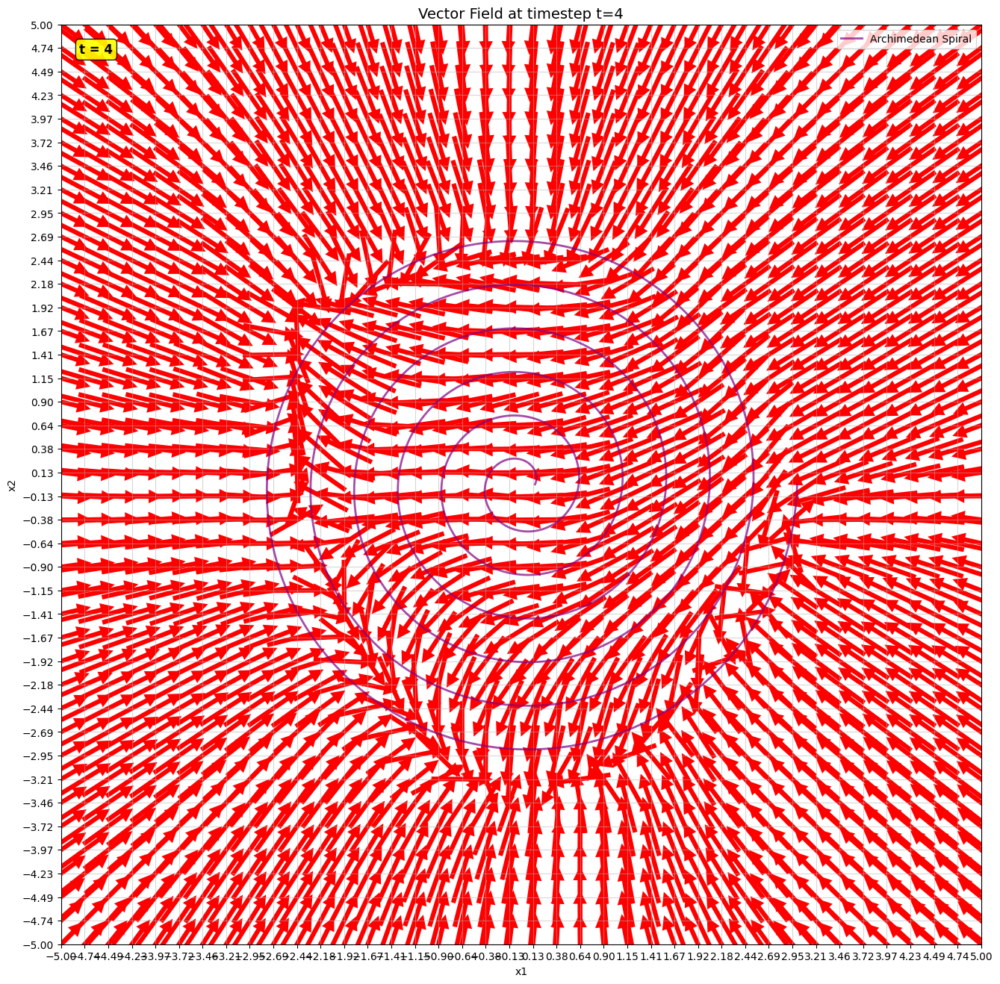

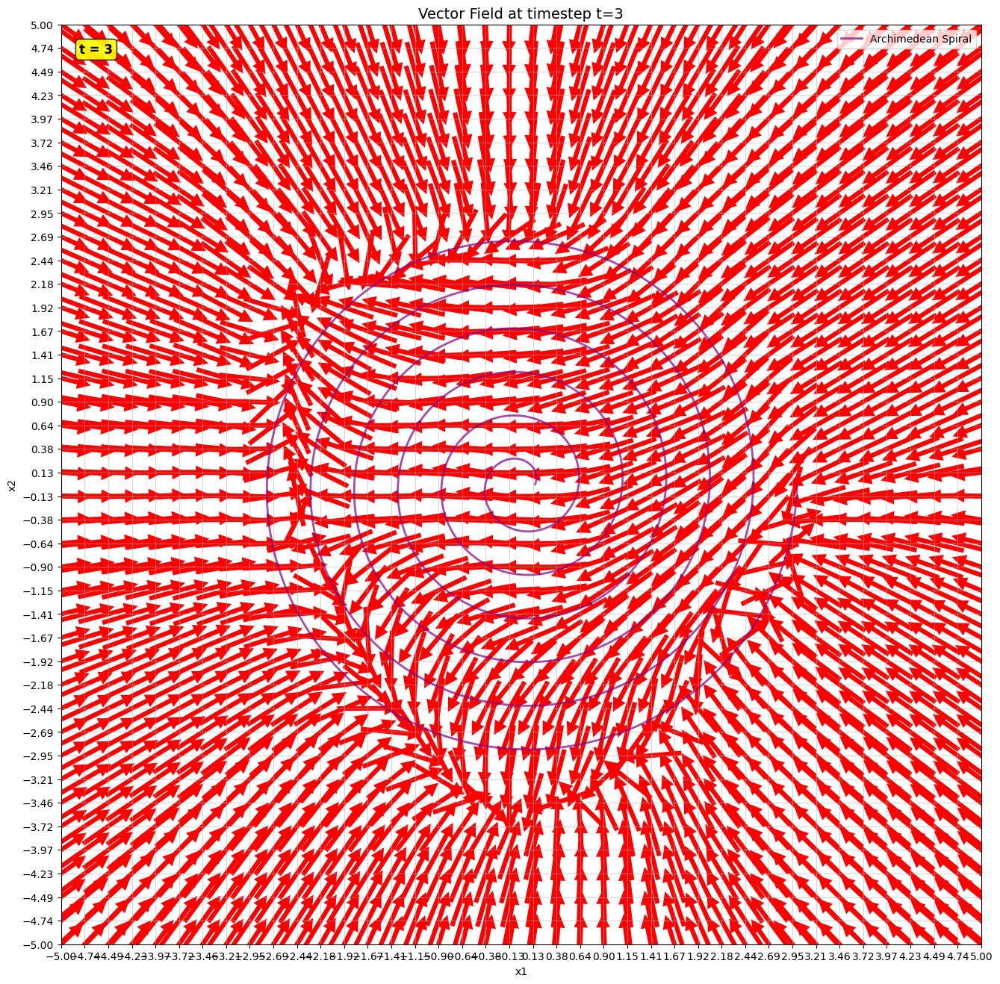

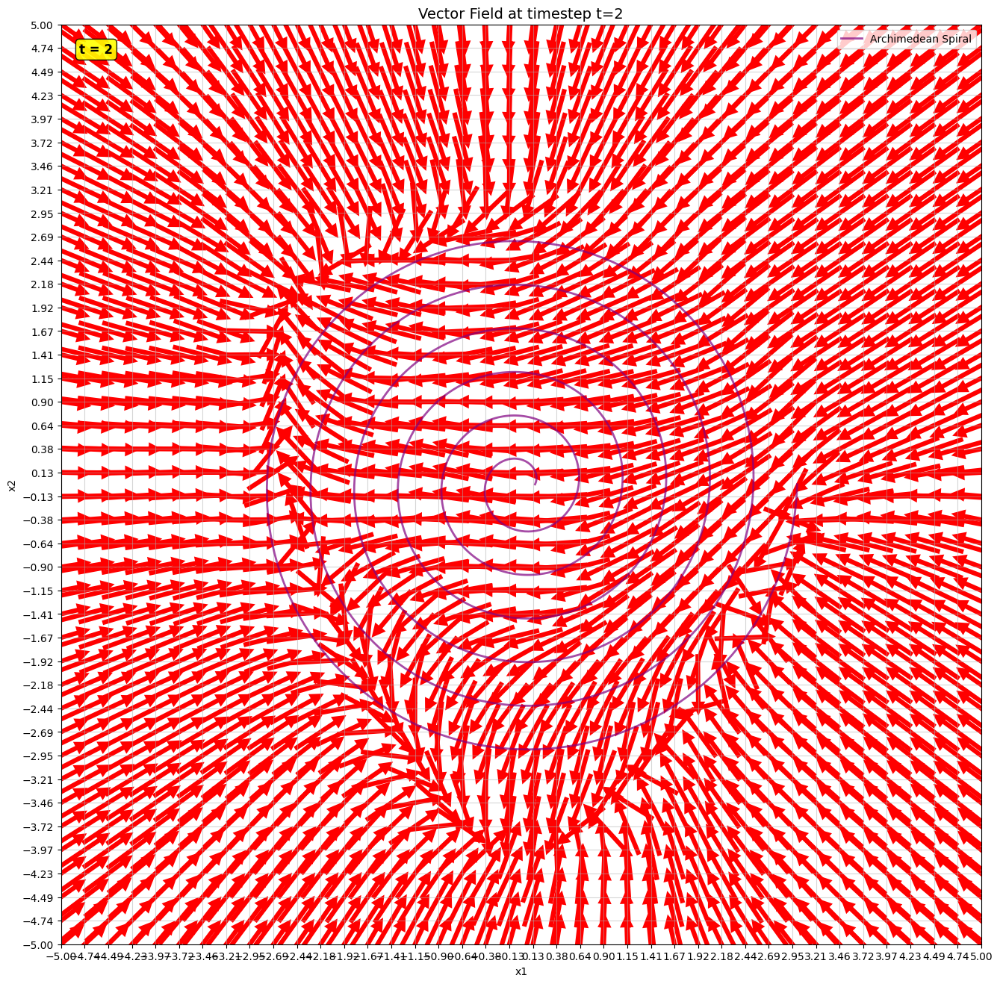

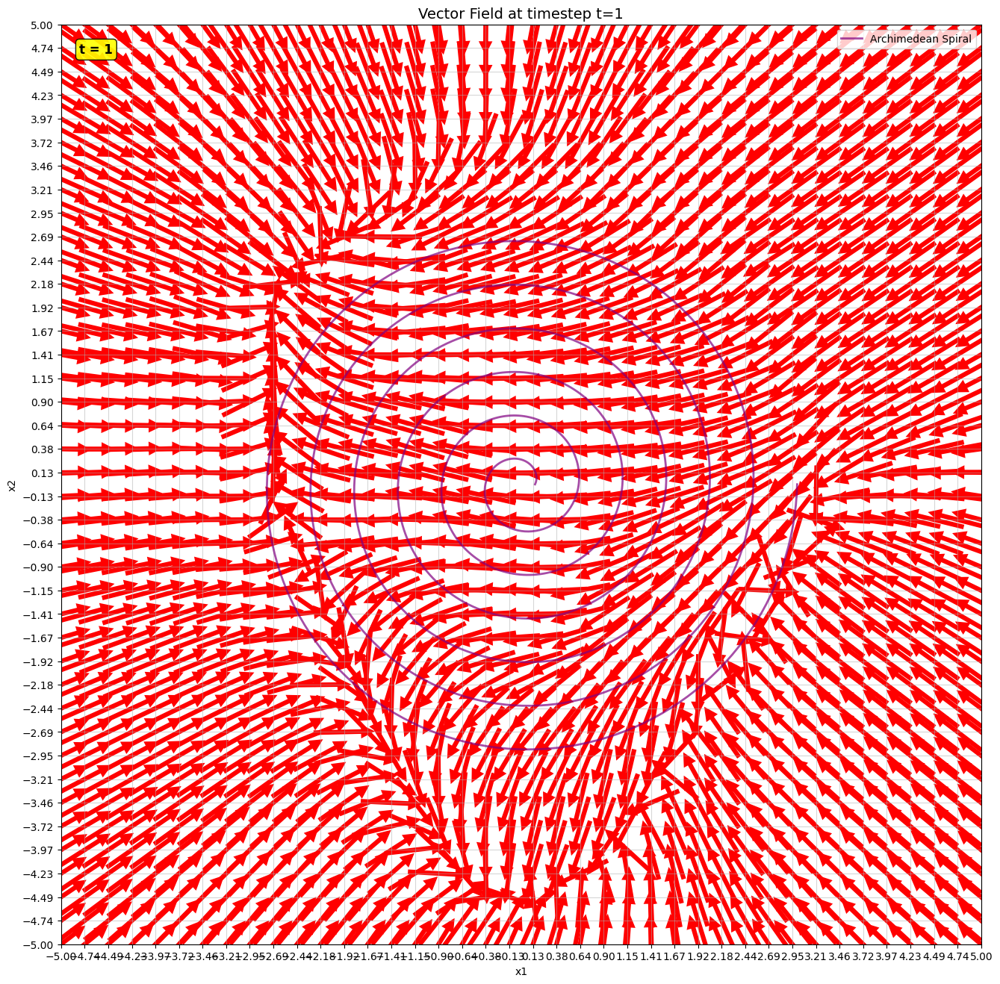

: 

In [ ]:
timesteps = [1000, 500, 200, 100, 50, 20, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1]
for t in timesteps:
    draw_vector_field_at_time(model, t, show_spiral=True, show_grid=True, x_range=(-5, 5, 40), y_range=(-5, 5, 40), normalize=True)


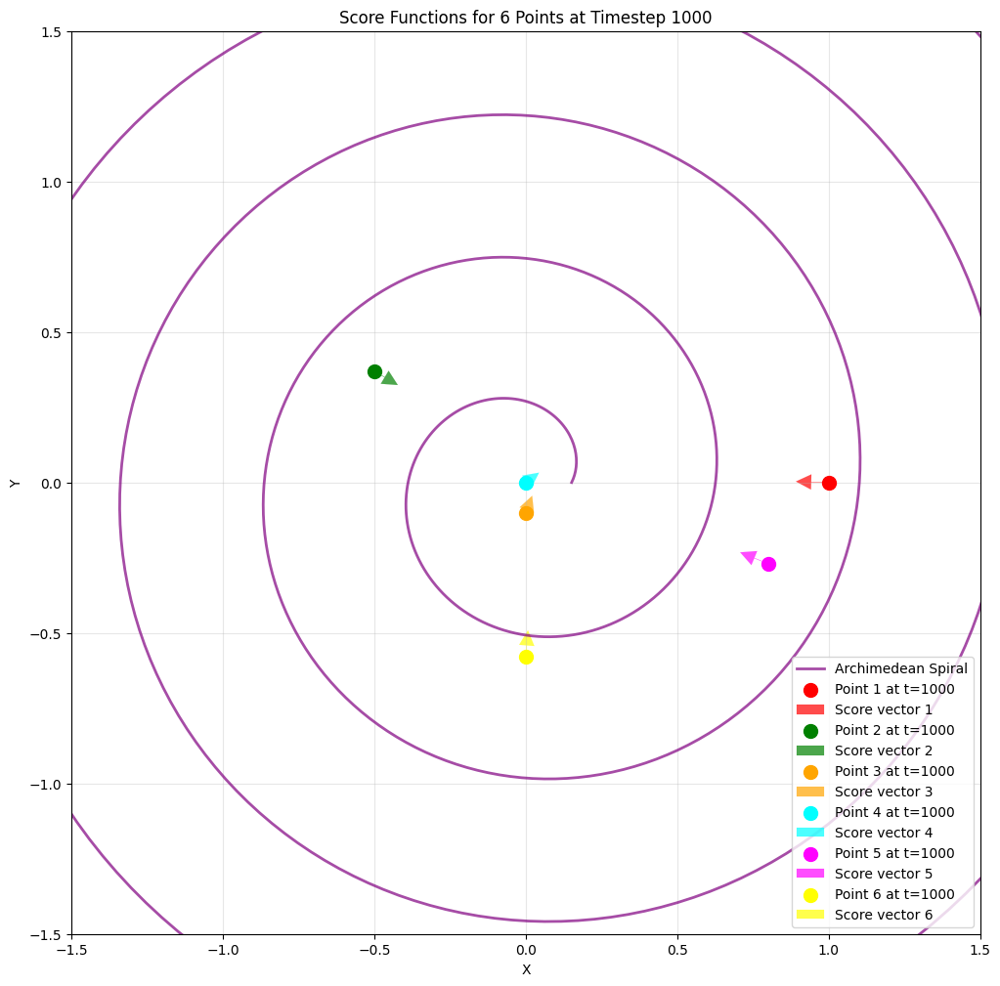

100


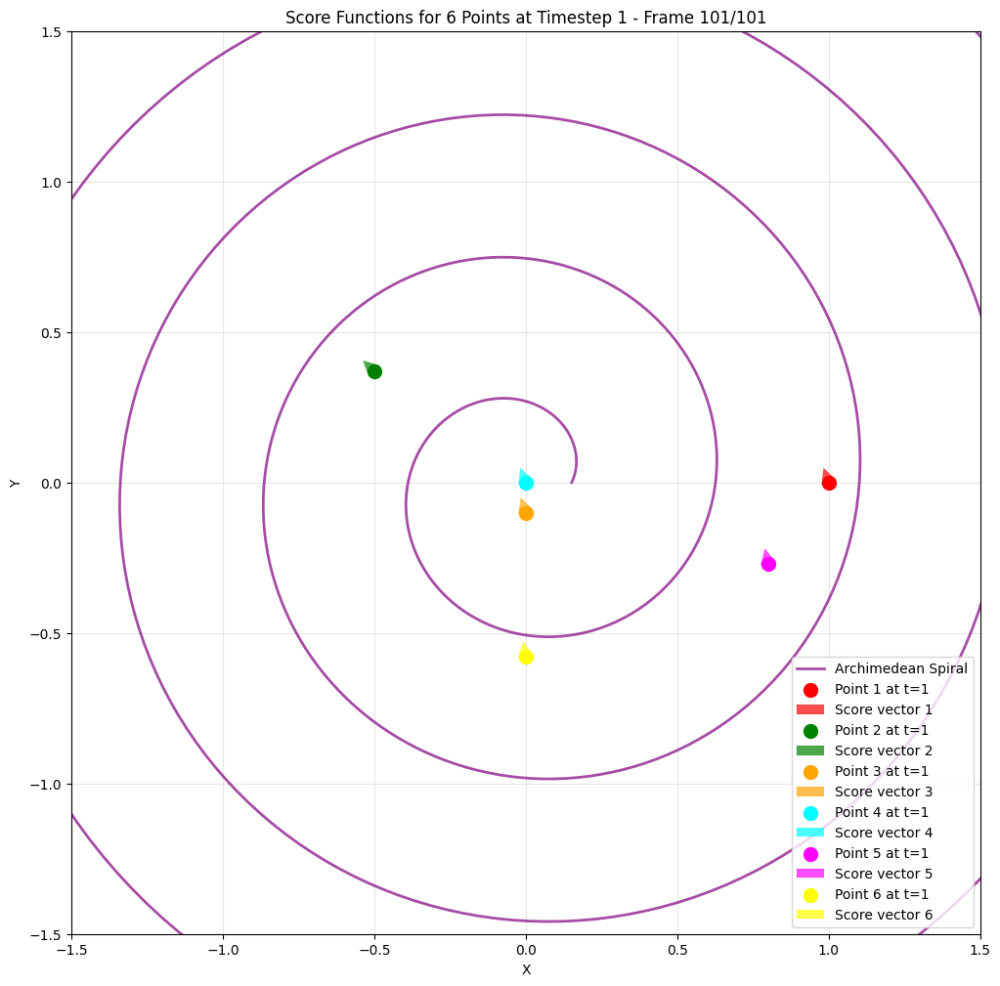

In [165]:
def plot_score_at_timestep(model, x_t, t, ax=None, fig=None, show_spiral=False):
    """
    Plot the score function (e_hat) for given point(s) x_t at timestep t
    
    Args:
        model: The DDPM model
        x_t: The point(s) - can be single point [2] or batch [N, 2]
        t: The timestep
        show_spiral: If True, plot the Archimedean spiral
        ax: Matplotlib axis (optional)
        fig: Matplotlib figure (optional)
    """
    if ax is None:
        fig, ax = plt.subplots(figsize=(12, 12))
    
    # Draw the Archimedean spiral if requested
    if show_spiral:
        t_spiral = np.linspace(0, 12 * np.pi, 1000)
        max_t = A + B * MAX_T 
        r_spiral = (A + B * t_spiral) / max_t * 3
        x_spiral = r_spiral * np.cos(t_spiral)
        y_spiral = r_spiral * np.sin(t_spiral)
        ax.plot(x_spiral, y_spiral, 'purple', linewidth=2, alpha=0.7, label='Archimedean Spiral')
    
    # Ensure x_t is a tensor on the correct device
    if not isinstance(x_t, torch.Tensor):
        x_t = torch.tensor(x_t, dtype=torch.float32, device='mps')
    elif x_t.device.type != 'mps':
        x_t = x_t.to('mps')
    
    # Handle both single points and batches
    if x_t.dim() == 1:
        # Single point [2] -> [1, 2]
        x_t = x_t.unsqueeze(0)
        batch_size = 1
    else:
        # Batch of points [N, 2]
        batch_size = x_t.shape[0]
    
    # Get the denoised sample and score
    x_denoised, pre_scale, e_scale, e_hat, post_sigma = model.denoise_sample(
        x_t, t
    )
    
    # Convert to numpy for plotting
    x_t_np = x_t.cpu().numpy()
    e_hat_np = - e_hat.cpu().numpy() * e_scale * pre_scale

    
    # Define colors for different points
    colors = ['red', 'green', 'orange', 'cyan', 'magenta', 'yellow', 'black', 'blue']
    
    # Plot each point and its score vector
    for i in range(batch_size):
        color = colors[i % len(colors)]
        
        # Plot the point
        ax.scatter(x_t_np[i, 0], x_t_np[i, 1], c=color, s=100, zorder=5, 
                  label=f'Point {i+1} at t={t}')
        
        # Plot the score vector (e_hat)
        ax.arrow(x_t_np[i, 0], x_t_np[i, 1], 
                e_hat_np[i, 0], e_hat_np[i, 1], 
                head_width=0.05, head_length=0.05, fc=color, ec=color, 
                linewidth=0.1, alpha=0.7, 
                label=f'Score vector {i+1}')
    
    # Set labels and title
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    if batch_size == 1:
        ax.set_title(f'Score Function at Timestep {t}')
    else:
        ax.set_title(f'Score Functions for {batch_size} Points at Timestep {t}')
    ax.legend()
    ax.grid(True, alpha=0.3)
    
    # Set axis limits
    ax.set_xlim(-1.5, 1.5)
    ax.set_ylim(-1.5, 1.5)
    
    return ax


def animate_score_evolution(model, x_t, timestep_interval=1, show_spiral=False):
    """
    Create an animation showing how the score function evolves for given point(s)
    across all timesteps from model.T to 1
    
    Args:
        model: The DDPM model
        x_t: The point(s) - can be single point [2] or batch [N, 2]
        timestep_interval: Show every nth timestep (default: 1)
        show_spiral: If True, plot the Archimedean spiral
    """
    # Create timesteps array (from model.T down to 1)
    timesteps = list(range(model.T, 0, -timestep_interval))
    print(len(timesteps))
    if timesteps[-1] != 1:
        timesteps.append(1)  # Make sure we include t=1
    
    # Set up the figure
    fig, ax = plt.subplots(figsize=(12, 12))
    
    def animate_frame(frame_idx):
        """Function called for each frame of the animation"""
        
        ax.clear()
        
        t = timesteps[frame_idx]
        plot_score_at_timestep(model, x_t, t, show_spiral=show_spiral, ax=ax, fig=fig)
        
        # Add frame info to title
        current_title = ax.get_title()
        ax.set_title(f'{current_title} - Frame {frame_idx+1}/{len(timesteps)}')
        
        return ax.get_children()
    
    # Create animation
    anim = animation.FuncAnimation(
        fig, animate_frame, frames=len(timesteps), 
        interval=70, blit=False, repeat=True
    )
    
    return HTML(anim.to_jshtml())


# Now your test code will work correctly:
test_points = [[1.0, 0.0], [-0.5, 0.37], [0.0, -0.1], [0.0, 0.0], [0.8, -.27], [0.0, -0.58]]
test_points = torch.tensor(test_points, dtype=torch.float32, device='mps')

# Plot score at a specific timestep for all points
plot_score_at_timestep(model, test_points, 1000, show_spiral=True)
plt.show()

# Create animation of score evolution for all points
animate_score_evolution(model, test_points, timestep_interval=10, show_spiral=True)